# Bayesian MMNN: Config A vs Config B

**Config A**: W,b become Bayesian with prior `N(W_init, prior_scale)`. A,c stay deterministic (trainable).
- Principled prior: explores random feature maps near the initialization.

**Config B**: W,b stay frozen. A,c become Bayesian with prior `N(0, prior_scale)`.
- Exploits near-convexity of the A,c landscape per layer.

**Inference methods**: SVI, NUTS, Custom HMC

**Epistemic test**: Data gap in [0.5, 0.8] — uncertainty should increase there.

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import math
import copy
import os
from torch.utils.data import DataLoader, TensorDataset
from torch.nn.utils import parameters_to_vector, vector_to_parameters
from tqdm import tqdm, trange
from scipy.stats import norm
import matplotlib.pyplot as plt

# Pyro
import pyro
import pyro.distributions as dist
from pyro.distributions import constraints
from pyro.nn import PyroModule
from pyro.infer import SVI, Trace_ELBO, Predictive, MCMC, NUTS
from pyro.infer.autoguide import AutoDiagonalNormal
from pyro.optim import ClippedAdam,ExponentialLR

# Project
from mmnn import MMNN, SinTu
from data_sets.generate_data_sets import TestFunctions

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

/work/Sebas/miniconda3/envs/MMNN/lib/python3.13/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Using device: cuda


## Data Generation

- Noisy region in [-0.2, 0.2] (aleatoric uncertainty)
- **Data gap in [0.5, 0.8]** (epistemic uncertainty test)
- Extrapolation beyond [-1, 1]

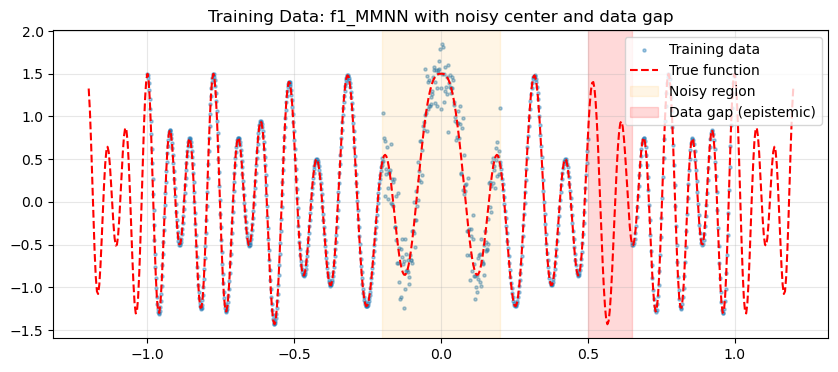

In [2]:
f1 = TestFunctions.f1_MMNN

torch.manual_seed(42)

# Clean regions (EXCLUDING [0.5, 0.8] for epistemic gap)
x_clean = torch.cat([
    torch.linspace(-1, -0.2, 500),
    torch.linspace(0.2, 0.5, 150),     # stops at 0.5
    torch.linspace(0.65, 1.0, 150),     # resumes at 0.65
]).to(device)
y_clean = f1(x_clean)

# Noisy region in [-0.2, 0.2]
x_noisy = torch.linspace(-0.2, 0.2, 200).to(device)
y_noisy = f1(x_noisy) + 0.25 * torch.randn_like(x_noisy)

x_train = torch.cat([x_clean, x_noisy], dim=0)
y_train = torch.cat([y_clean, y_noisy], dim=0)

# Sort by x
idx = torch.argsort(x_train)
x_train = x_train[idx].unsqueeze(1)
y_train = y_train[idx].unsqueeze(1)

# Test (with extrapolation)
x_test = torch.linspace(-1.2, 1.2, 600).to(device).unsqueeze(1)
y_test_true = f1(x_test)

# DataLoader
train_loader = DataLoader(TensorDataset(x_train, y_train), batch_size=100, shuffle=True)

# Plot
plt.figure(figsize=(10, 4))
plt.scatter(x_train.cpu(), y_train.cpu(), s=5, alpha=0.4, label='Training data')
plt.plot(x_test.cpu(), y_test_true.cpu(), 'r--', lw=1.5, label='True function')
plt.axvspan(-0.2, 0.2, alpha=0.1, color='orange', label='Noisy region')
plt.axvspan(0.5, 0.65, alpha=0.15, color='red', label='Data gap (epistemic)')
plt.legend()
plt.title('Training Data: f1_MMNN with noisy center and data gap')
plt.grid(True, alpha=0.3)
plt.show()

## Hyperparameters

In [26]:
# Architecture
num_layers = 6
ranks = [1] + [18] * (num_layers - 1) + [1]
widths = [388] * num_layers

# Bayesian config
n_bayesian_layers = 2
prior_scale = 0.05
noise_std_fixed = 0.05  # For custom HMC

# NUTS-specific settings (match test_pyro defaults)
prior_scale_nuts = 1.0
sigma_mode_A_nuts = 'sample'
sigma_mode_B_nuts = 'sample'

# Noise handling
sigma_mode_A = 'sample'  # 'sample' | 'param' | 'fixed'
sigma_mode_B = 'sample'   # 'sample' | 'param' | 'fixed'
sigma_init = 0.05

# Training
svi_epochs = 1500
svi_lr = 0.001
svi_lrd = 0.999          # Per-step LR decay factor (applied every svi.step())
nuts_samples = 400
nuts_warmup = 400
hmc_samples = 600
hmc_burn_in = 400
hmc_step_size = 0.001
hmc_leapfrog_steps = 50

## Model Definitions

### Shared: Deterministic MMNN layer (non-Bayesian layers)

In [4]:
class DeterministicMMNN_L(PyroModule):
    """Standard MMNN layer: W,b frozen (buffers), A,c deterministic (optimizable by SVI).
    
    Inherits from PyroModule so that self.trainable's parameters are properly
    registered in Pyro's param store and updated by SVI.
    Frozen W,b are stored as buffers (not nn.Parameters) so they are NOT lifted
    to pyro.param() and remain truly frozen.
    """
    def __init__(self, in_features, out_features, width, device=None, activation=None):
        super().__init__()
        self.activation = SinTu() if activation is None else activation
        
        # Frozen W,b as buffers — invisible to Pyro's param store
        temp = nn.Linear(in_features, width, device=device)
        self.register_buffer('W_frozen', temp.weight.data)
        self.register_buffer('b_frozen', temp.bias.data)
        
        # Trainable A,c — lifted to pyro.param() by PyroModule machinery
        self.trainable = PyroModule[nn.Linear](width, out_features, device=device)

    def forward(self, x):
        x = F.linear(x, self.W_frozen, self.b_frozen)
        x = self.activation(x)
        return self.trainable(x)

### Config A: Bayesian W,b (prior = N(W_init, σ)), deterministic A,c

In [5]:
# ============================================================================
# Config A — Pyro layers
# ============================================================================

class ConfigA_L_Pyro(PyroModule):
    """Config A layer: W,b Bayesian with fixed mean, trainable std; A,c deterministic.
    The mean is the random initialization — exploring nearby feature maps with learned scale.
    """
    def __init__(self, in_features, out_features, width, layer_idx,
                 device=None, prior_scale=0.1, activation=None):
        super().__init__()
        self.layer_idx = layer_idx
        self.device = device
        self.activation = SinTu() if activation is None else activation

        # Initialize W,b and store as prior means (fixed)
        temp = nn.Linear(in_features, width, device=device)
        self.register_buffer('W_prior_mean', temp.weight.data.clone())
        self.register_buffer('b_prior_mean', temp.bias.data.clone())

        # Store initial scale; stds are fetched via pyro.param in forward to avoid graph reuse
        self.register_buffer('prior_scale', torch.tensor(prior_scale, device=device))

        # Deterministic A,c (trainable via Pyro param store)
        self.trainable = PyroModule[nn.Linear](width, out_features, device=device)

    def forward(self, x):
        # Sample W, b: mean fixed at random initialization, std learned
        W_std = pyro.param(
            f"W_std_{self.layer_idx}",
            self.prior_scale.clone(),
            constraint=constraints.positive
        )
        b_std = pyro.param(
            f"b_std_{self.layer_idx}",
            self.prior_scale.clone(),
            constraint=constraints.positive
        )
        W = pyro.sample(
            f"W_{self.layer_idx}",
            dist.Normal(self.W_prior_mean, W_std).to_event(2)
        )
        b = pyro.sample(
            f"b_{self.layer_idx}",
            dist.Normal(self.b_prior_mean, b_std).to_event(1)
        )

        x = F.linear(x, W, b)  # Bayesian W,b
        x = self.activation(x)
        x = self.trainable(x)  # Deterministic A,c
        return x


class BayesianMMNN_ConfigA(PyroModule):
    """Config A: last n layers have Bayesian W,b, deterministic A,c."""
    def __init__(self, ranks, widths, device='cpu', prior_scale=0.1,
                 n_bayesian_layers=None, activation=None,
                 sigma_mode='sample', sigma_init=0.05):
        super().__init__()
        self.depth = len(widths)
        self.device = device
        self.sigma_mode = sigma_mode
        self.sigma_init = sigma_init

        if n_bayesian_layers is None:
            n_bayesian_layers = self.depth
        n_bayesian_layers = max(0, min(n_bayesian_layers, self.depth))
        self.n_bayesian_layers = n_bayesian_layers
        self.bayesian_start_idx = self.depth - n_bayesian_layers

        self.layers = nn.ModuleList()
        for j in range(self.depth):
            if j >= self.bayesian_start_idx:
                layer = ConfigA_L_Pyro(
                    in_features=ranks[j], out_features=ranks[j+1],
                    width=widths[j], layer_idx=j,
                    device=device, prior_scale=prior_scale,
                    activation=activation
                )
            else:
                layer = DeterministicMMNN_L(
                    in_features=ranks[j], out_features=ranks[j+1],
                    width=widths[j], device=device, activation=activation
                )
            self.layers.append(layer)

        print(f"Config A: Bayesian W,b in layers {self.bayesian_start_idx}..{self.depth-1}")

    def forward(self, x, y=None):
        if x.dim() == 1:
            x = x.unsqueeze(-1)
        for layer in self.layers:
            x = layer(x)
        mu = x.squeeze(-1)

        if self.sigma_mode == 'sample':
            sigma = pyro.sample("sigma", dist.Gamma(
                torch.tensor(2.0, device=self.device),
                torch.tensor(1.0, device=self.device)
            ))
        elif self.sigma_mode == 'param':
            sigma = pyro.param(
                "sigma",
                torch.tensor(self.sigma_init, device=self.device),
                constraint=constraints.positive
            )
        else:  # 'fixed'
            sigma = torch.tensor(self.sigma_init, device=self.device)

        with pyro.plate("data", mu.shape[0]):
            pyro.sample("obs", dist.Normal(mu, sigma), obs=y)
        return mu


### Config B: Frozen W,b, Bayesian A,c (prior = N(0, σ))

In [6]:
# ============================================================================
# Config B — Pyro (single class, direct MMNN construction)
# ============================================================================

class BayesianMMNN_ConfigB(PyroModule):
    """Config B: frozen W,b everywhere; A,c deterministic in early layers,
    and Bayesian *perturbations* around deterministic A,c in last n layers.
    Directly constructs the MMNN without separate layer classes.
    """
    def __init__(self, ranks, widths, device='cpu', prior_scale=0.1,
                 n_bayesian_layers=None, activation=None,
                 sigma_mode='param', sigma_init=0.05):
        super().__init__()
        self.depth = len(widths)
        self.device = device
        self.activation = SinTu() if activation is None else activation
        self.sigma_mode = sigma_mode
        self.sigma_init = sigma_init

        if n_bayesian_layers is None:
            n_bayesian_layers = self.depth
        n_bayesian_layers = max(0, min(n_bayesian_layers, self.depth))
        self.n_bayesian_layers = n_bayesian_layers
        self.bayesian_start_idx = self.depth - n_bayesian_layers

        # Frozen W,b for every layer
        for j in range(self.depth):
            temp = nn.Linear(ranks[j], widths[j], device=device)
            self.register_buffer(f'W_frozen_{j}', temp.weight.data.clone())
            self.register_buffer(f'b_frozen_{j}', temp.bias.data.clone())

        # Deterministic A,c for ALL layers (acts as base; Bayesian layers add noise)
        self.det_ac = nn.ModuleList([
            PyroModule[nn.Linear](widths[j], ranks[j+1], device=device)
            for j in range(self.depth)
        ])

        # Prior buffers for Bayesian perturbations (zero-centered)
        self.register_buffer('prior_scale', torch.tensor(prior_scale, device=device))
        for j in range(self.bayesian_start_idx, self.depth):
            A_prior = torch.zeros(ranks[j+1], widths[j], device=device)
            c_prior = torch.zeros(ranks[j+1], device=device)
            self.register_buffer(f'A_prior_mean_{j}', A_prior)
            self.register_buffer(f'c_prior_mean_{j}', c_prior)

        print(f"Config B: Bayesian A,c perturbations in layers {self.bayesian_start_idx}..{self.depth-1}")

    def forward(self, x, y=None):
        if x.dim() == 1:
            x = x.unsqueeze(-1)
        for j in range(self.depth):
            W = getattr(self, f'W_frozen_{j}')
            b = getattr(self, f'b_frozen_{j}')
            x = F.linear(x, W, b)
            x = self.activation(x)

            if j < self.bayesian_start_idx:
                x = self.det_ac[j](x)
            else:
                # Base (deterministic) A,c
                A_loc = self.det_ac[j].weight
                c_loc = self.det_ac[j].bias

                # Bayesian perturbations around the base
                A_prior = getattr(self, f'A_prior_mean_{j}')
                c_prior = getattr(self, f'c_prior_mean_{j}')
                dA = pyro.sample(
                    f"dA_{j}",
                    dist.Normal(A_prior, self.prior_scale).to_event(2)
                )
                dc = pyro.sample(
                    f"dc_{j}",
                    dist.Normal(c_prior, self.prior_scale).to_event(1)
                )
                x = F.linear(x, A_loc + dA, c_loc + dc)

        mu = x.squeeze(-1)
        if self.sigma_mode == 'sample':
            sigma = pyro.sample("sigma", dist.Gamma(
                torch.tensor(2.0, device=self.device),
                torch.tensor(1.0, device=self.device)
            ))
        elif self.sigma_mode == 'param':
            sigma = pyro.param(
                "sigma",
                torch.tensor(self.sigma_init, device=self.device),
                constraint=constraints.positive
            )
        else:  # 'fixed'
            sigma = torch.tensor(self.sigma_init, device=self.device)

        with pyro.plate("data", mu.shape[0]):
            pyro.sample("obs", dist.Normal(mu, sigma), obs=y)
        return mu


### Custom HMC Models (PyTorch only)

In [7]:
# ============================================================================
# Config A — Custom HMC model
# ============================================================================

class MMNN_ConfigA_HMC(nn.Module):
    """Config A for HMC: W,b Bayesian (HMC), A,c deterministic (MAP).
    Prior centered at W_init.
    """
    def __init__(self, ranks, widths, device='cpu', prior_var=0.01,
                 n_bayesian_layers=None, activation=None):
        super().__init__()
        self.ranks = ranks
        self.widths = widths
        self.depth = len(widths)
        self.device = device
        self.prior_var = prior_var
        self.activation = SinTu() if activation is None else activation

        if n_bayesian_layers is None:
            n_bayesian_layers = self.depth
        self.n_bayesian_layers = max(0, min(n_bayesian_layers, self.depth))
        self.bayesian_start_idx = self.depth - self.n_bayesian_layers

        # Build fcs in MMNN interleaved format: [W0,A0,W1,A1,...]
        fc_sizes = [ranks[0]]
        for j in range(self.depth):
            fc_sizes += [widths[j], ranks[j + 1]]

        fcs = []
        for j in range(len(fc_sizes) - 1):
            fcs.append(nn.Linear(fc_sizes[j], fc_sizes[j + 1], device=device))
        self.fcs = nn.ModuleList(fcs)

        self.hmc_params = []
        self.map_params = []

        # Config A: W,b (even) are Bayesian for last n layers, A,c (odd) are MAP in all layers
        for j in range(self.depth):
            wb_idx = 2 * j
            ac_idx = 2 * j + 1
            is_bayesian = (j >= self.bayesian_start_idx)
            self.register_buffer(f'is_bayesian_{j}', torch.tensor(is_bayesian))

            if is_bayesian:
                # W,b: Bayesian (HMC), prior centered at init
                self.fcs[wb_idx].weight.requires_grad = True
                self.fcs[wb_idx].bias.requires_grad = True
                self.hmc_params += [self.fcs[wb_idx].weight, self.fcs[wb_idx].bias]

                self.register_buffer(f'prior_mean_w_{j}', self.fcs[wb_idx].weight.data.clone())
                self.register_buffer(f'prior_mean_b_{j}', self.fcs[wb_idx].bias.data.clone())
                n_in = fc_sizes[wb_idx]
                self.register_buffer(f'prior_std_w_{j}', torch.tensor(math.sqrt(prior_var / n_in)))
                self.register_buffer(f'prior_std_b_{j}', torch.tensor(math.sqrt(prior_var)))
            else:
                # W,b frozen for non-Bayesian layers
                self.fcs[wb_idx].weight.requires_grad = False
                self.fcs[wb_idx].bias.requires_grad = False

            # A,c are MAP parameters for ALL layers
            self.fcs[ac_idx].weight.requires_grad = True
            self.fcs[ac_idx].bias.requires_grad = True
            self.map_params += [self.fcs[ac_idx].weight, self.fcs[ac_idx].bias]

        bayesian_params = sum(p.numel() for p in self.hmc_params)
        map_params = sum(p.numel() for p in self.map_params)
        total_params = sum(p.numel() for p in self.parameters())
        print(f"Config A HMC: Bayesian W,b params: {bayesian_params} | MAP A,c params: {map_params} | total: {total_params}")

    def forward(self, x):
        for j in range(self.depth):
            x = self.fcs[2 * j](x)       # W,b
            x = self.activation(x)
            x = self.fcs[2 * j + 1](x)   # A,c
        return x

    def potential_energy(self, x, y, noise_std=0.05):
        y_pred = self.forward(x)
        nll = 0.5 * torch.sum((y - y_pred) ** 2) / (noise_std ** 2)
        log_prior = 0.0
        for j in range(self.depth):
            if getattr(self, f'is_bayesian_{j}', False):
                wb_idx = 2 * j
                std_w = getattr(self, f'prior_std_w_{j}')
                std_b = getattr(self, f'prior_std_b_{j}')
                mean_w = getattr(self, f'prior_mean_w_{j}')
                mean_b = getattr(self, f'prior_mean_b_{j}')
                log_prior += 0.5 * torch.sum((self.fcs[wb_idx].weight - mean_w) ** 2) / (std_w ** 2)
                log_prior += 0.5 * torch.sum((self.fcs[wb_idx].bias - mean_b) ** 2) / (std_b ** 2)
        return nll + log_prior


# ============================================================================
# Config B — Custom HMC model
# ============================================================================

class MMNN_ConfigB_HMC(nn.Module):
    """Config B for HMC: W,b frozen; A,c MAP in all layers;
    Bayesian perturbations on A,c for last n layers.
    Prior on perturbations centered at zero.
    """
    def __init__(self, ranks, widths, device='cpu', prior_var=0.01,
                 n_bayesian_layers=None, activation=None):
        super().__init__()
        self.ranks = ranks
        self.widths = widths
        self.depth = len(widths)
        self.device = device
        self.prior_var = prior_var
        self.activation = SinTu() if activation is None else activation

        if n_bayesian_layers is None:
            n_bayesian_layers = self.depth
        self.n_bayesian_layers = max(0, min(n_bayesian_layers, self.depth))
        self.bayesian_start_idx = self.depth - self.n_bayesian_layers

        fc_sizes = [ranks[0]]
        for j in range(self.depth):
            fc_sizes += [widths[j], ranks[j + 1]]

        fcs = []
        for j in range(len(fc_sizes) - 1):
            fcs.append(nn.Linear(fc_sizes[j], fc_sizes[j + 1], device=device))
        self.fcs = nn.ModuleList(fcs)

        self.hmc_params = []
        self.map_params = []

        # Config B: W,b frozen; A,c MAP; perturbations Bayesian for last n layers
        for j in range(self.depth):
            wb_idx = 2 * j
            ac_idx = 2 * j + 1
            is_bayesian = (j >= self.bayesian_start_idx)
            self.register_buffer(f'is_bayesian_{j}', torch.tensor(is_bayesian))

            # W,b always frozen
            self.fcs[wb_idx].weight.requires_grad = False
            self.fcs[wb_idx].bias.requires_grad = False

            # A,c base are MAP parameters
            self.fcs[ac_idx].weight.requires_grad = True
            self.fcs[ac_idx].bias.requires_grad = True
            self.map_params += [self.fcs[ac_idx].weight, self.fcs[ac_idx].bias]

            if is_bayesian:
                # Bayesian perturbations dA, dc
                dA = nn.Parameter(torch.zeros_like(self.fcs[ac_idx].weight))
                dc = nn.Parameter(torch.zeros_like(self.fcs[ac_idx].bias))
                setattr(self, f'dA_{j}', dA)
                setattr(self, f'dc_{j}', dc)
                self.hmc_params += [dA, dc]

                n_in = widths[j]
                self.register_buffer(f'prior_std_w_{j}', torch.tensor(math.sqrt(prior_var / n_in)))
                self.register_buffer(f'prior_std_b_{j}', torch.tensor(math.sqrt(prior_var)))

        bayesian_params = sum(p.numel() for p in self.hmc_params)
        map_params = sum(p.numel() for p in self.map_params)
        total_params = sum(p.numel() for p in self.parameters())
        print(f"Config B HMC: Bayesian dA,dc params: {bayesian_params} | MAP A,c params: {map_params} | total: {total_params}")

    def forward(self, x):
        for j in range(self.depth):
            x = self.fcs[2 * j](x)
            x = self.activation(x)
            ac_idx = 2 * j + 1
            A = self.fcs[ac_idx].weight
            c = self.fcs[ac_idx].bias

            if getattr(self, f'is_bayesian_{j}', False):
                dA = getattr(self, f'dA_{j}')
                dc = getattr(self, f'dc_{j}')
                A = A + dA
                c = c + dc
            x = F.linear(x, A, c)
        return x

    def potential_energy(self, x, y, noise_std=0.05):
        y_pred = self.forward(x)
        nll = 0.5 * torch.sum((y - y_pred) ** 2) / (noise_std ** 2)
        log_prior = 0.0
        for j in range(self.depth):
            if getattr(self, f'is_bayesian_{j}', False):
                std_w = getattr(self, f'prior_std_w_{j}')
                std_b = getattr(self, f'prior_std_b_{j}')
                dA = getattr(self, f'dA_{j}')
                dc = getattr(self, f'dc_{j}')
                log_prior += 0.5 * torch.sum(dA ** 2) / (std_w ** 2)
                log_prior += 0.5 * torch.sum(dc ** 2) / (std_b ** 2)
        return nll + log_prior


In [8]:
# ============================================================================
# Custom HMC Sampler & Utilities (shared by both configs)
# ============================================================================

class HMC_Sampler:
    def __init__(self, model, hmc_params, step_size=1e-2, num_steps=10):
        self.model = model
        self.step_size = step_size
        self.num_steps = num_steps
        self.params = list(hmc_params)

    def _potential_and_grad(self, x_data, y_data, noise_std):
        for p in self.params:
            if p.grad is not None:
                p.grad = None
        U = self.model.potential_energy(x_data, y_data, noise_std=noise_std)
        grads = torch.autograd.grad(U, self.params)
        return U, grads

    def step(self, x_data, y_data, noise_std=0.05):
        current_q = parameters_to_vector(self.params)
        current_p = torch.randn_like(current_q)

        current_U, current_grads = self._potential_and_grad(x_data, y_data, noise_std)
        current_K = 0.5 * torch.sum(current_p**2)
        current_H = current_U + current_K

        q = current_q.clone()
        p = current_p.clone()
        grad_vec = parameters_to_vector([g.clone() for g in current_grads])

        p = p - 0.5 * self.step_size * grad_vec
        for i in range(self.num_steps):
            q = q + self.step_size * p
            vector_to_parameters(q, self.params)
            new_U, new_grads = self._potential_and_grad(x_data, y_data, noise_std)
            grad_vec = parameters_to_vector(new_grads)
            if i != self.num_steps - 1:
                p = p - self.step_size * grad_vec
        p = p - 0.5 * self.step_size * grad_vec

        new_K = 0.5 * torch.sum(p**2)
        diff = current_H - (new_U + new_K)

        if torch.rand(1).item() < torch.exp(torch.clamp(diff, max=0)).item():
            return new_U.item(), True
        else:
            vector_to_parameters(current_q, self.params)
            return current_U.item(), False



def run_hmc(model, x_train, y_train, num_samples=500, burn_in=200,
            step_size=0.001, num_steps=50, noise_std=0.05, device='cpu',
            map_lr=1e-3, map_steps=1):
    hmc_params = getattr(model, 'hmc_params', [p for p in model.parameters() if p.requires_grad])
    map_params = getattr(model, 'map_params', [])

    if len(hmc_params) == 0:
        raise ValueError('No HMC parameters found. Check n_bayesian_layers.')

    sampler = HMC_Sampler(model, hmc_params, step_size=step_size, num_steps=num_steps)
    map_opt = torch.optim.Adam(map_params, lr=map_lr) if len(map_params) > 0 else None

    samples, potential_history = [], []
    accept_count = 0
    x_all, y_all = x_train.to(device), y_train.to(device)
    model.train()

    pbar = tqdm(range(num_samples + burn_in), desc="HMC")
    for i in pbar:
        # MAP step on deterministic parameters
        if map_opt is not None:
            for _ in range(map_steps):
                map_opt.zero_grad()
                U = model.potential_energy(x_all, y_all, noise_std=noise_std)
                U.backward()
                map_opt.step()
            # Clear any gradients on HMC params left by backward()
            for p in hmc_params:
                p.grad = None

        potential, accepted = sampler.step(x_all, y_all, noise_std=noise_std)
        potential_history.append(potential)
        if accepted:
            accept_count += 1
        if i >= burn_in:
            samples.append(copy.deepcopy(model.state_dict()))
        pbar.set_postfix({'U': f"{potential:.1f}", 'Acc': f"{accept_count/(i+1):.2f}"})

    print(f"Collected {len(samples)} samples. Acceptance: {accept_count/(num_samples+burn_in):.2%}")
    return samples, potential_history



def predict_hmc(model, samples, x, confidence_level=0.95):
    model.eval()
    x = x.to(model.device)
    preds = []
    with torch.no_grad():
        for sd in samples:
            model.load_state_dict(sd)
            preds.append(model(x).unsqueeze(0))
    pred_stack = torch.cat(preds, dim=0)
    mean, std = pred_stack.mean(dim=0), pred_stack.std(dim=0)
    z = norm.ppf((1 + confidence_level) / 2)
    return pred_stack, mean, std, mean - z * std, mean + z * std


In [9]:
# ============================================================================
# Plotting helper
# ============================================================================

x_np = x_test.cpu().numpy().flatten()
y_true_np = y_test_true.cpu().numpy().flatten()

def plot_predictions(mean, std, samples_np, title, ax_row=None):
    """3-panel plot: mean+CI, samples, std."""
    if ax_row is None:
        fig, axes = plt.subplots(1, 3, figsize=(18, 5))
    else:
        axes = ax_row
    
    # Mean + CI
    axes[0].scatter(x_train.cpu(), y_train.cpu(), s=5, alpha=0.2, c='gray')
    axes[0].plot(x_np, y_true_np, 'r--', lw=1.5, label='True')
    axes[0].plot(x_np, mean, 'b-', lw=1.5, label='Mean')
    axes[0].fill_between(x_np, mean - 2*std, mean + 2*std,
                         alpha=0.3, color='blue', label='$\\pm 2\\sigma$')
    axes[0].axvspan(0.5, 0.65, alpha=0.1, color='red')
    axes[0].set_title(f'{title}: Mean + CI'); axes[0].legend(fontsize=8)
    axes[0].grid(True, alpha=0.3)
    
    # Samples
    for i in range(min(50, samples_np.shape[0])):
        axes[1].plot(x_np, samples_np[i], alpha=0.1, color='blue')
    axes[1].plot(x_np, y_true_np, 'r--', lw=1.5)
    axes[1].axvspan(0.5, 0.65, alpha=0.1, color='red')
    axes[1].set_title(f'{title}: 50 Samples'); axes[1].grid(True, alpha=0.3)
    
    # Std
    axes[2].plot(x_np, std, 'g-', lw=2)
    axes[2].axvspan(-0.2, 0.2, alpha=0.1, color='orange', label='Noisy')
    axes[2].axvspan(0.5, 0.65, alpha=0.15, color='red', label='Gap')
    axes[2].axvline(-1, color='gray', ls='--', alpha=0.5)
    axes[2].axvline(1, color='gray', ls='--', alpha=0.5)
    axes[2].set_title(f'{title}: Std'); axes[2].set_xlabel('x')
    axes[2].legend(fontsize=8); axes[2].grid(True, alpha=0.3)
    
    return axes

## Pre-training (Optional)

**Commented out by design.** The models use randomly initialized W,b (Config A prior)
and zero-centered A,c prior (Config B). No data-driven pre-training needed.

In [10]:
# # ============================================================================
# # Optional: Pre-train a standard MMNN
# # WARNING: Using pre-trained weights as prior means is "double-dipping"
# # on the data. Only use for initialization, not for setting the prior.
# # ============================================================================
# from trainig.training import Trainer

# pretrained_mmnn = MMNN(
#     ranks=ranks, widths=widths, device=device,
#     ResNet=False, fixWb=True, init_scaling=True, activation=SinTu()
# )
# pretrained_mmnn.criterion = lambda pred, target: nn.MSELoss()(pred, target)

# optimizer_pt = torch.optim.Adam(pretrained_mmnn.parameters(), lr=1e-3)
# scheduler_pt = torch.optim.lr_scheduler.StepLR(optimizer_pt, step_size=500, gamma=0.9)

# trainer = Trainer(
#     model=pretrained_mmnn, device=device,
#     optimizer=optimizer_pt, scheduler=scheduler_pt
# )
# losses, loss_epochs = trainer.train(
#     x_train=x_train, y_train=y_train,
#     x_val=x_test, y_val=y_test_true,
#     epochs=2000, batch_size=100, verbose=True, validation_freq=500
# )
# trainer.plot_losses(losses, loss_epochs)

## Config A: SVI Training

Config A: Bayesian W,b in layers 4..5


A-SVI 0 | 12385.6:   0%|          | 0/1500 [00:01<?, ?it/s]

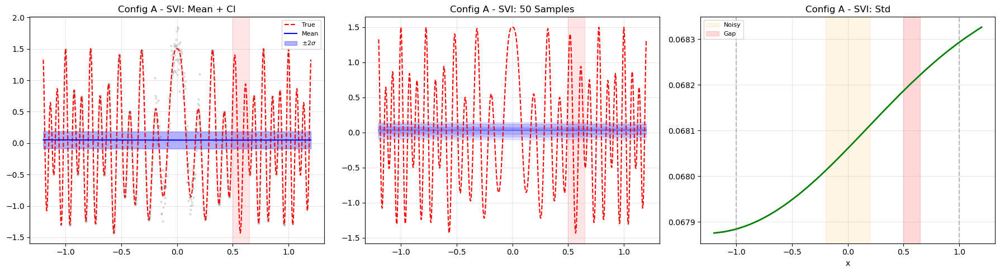

A-SVI 50 | 741.5:   3%|▎         | 50/1500 [00:34<14:50,  1.63it/s]  

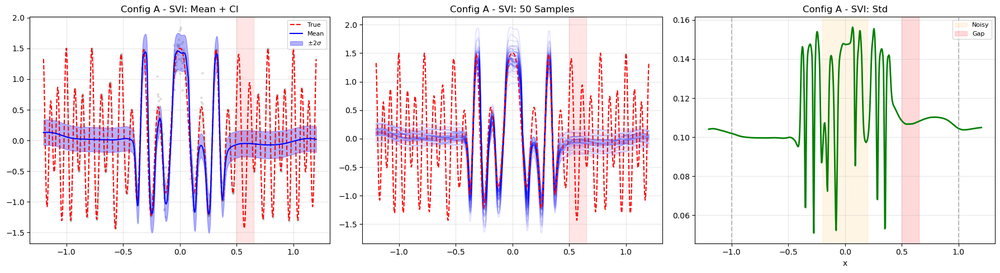

A-SVI 100 | 141.4:   7%|▋         | 100/1500 [01:06<14:15,  1.64it/s]

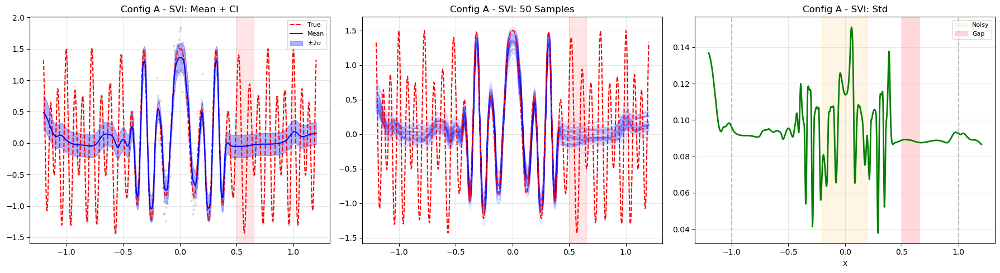

A-SVI 150 | 82.3:  10%|█         | 150/1500 [01:39<13:45,  1.63it/s] 

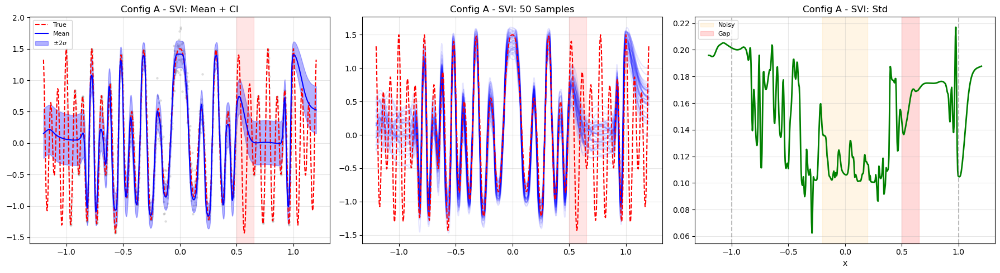

A-SVI 200 | 75.0:  13%|█▎        | 200/1500 [02:11<13:15,  1.63it/s]

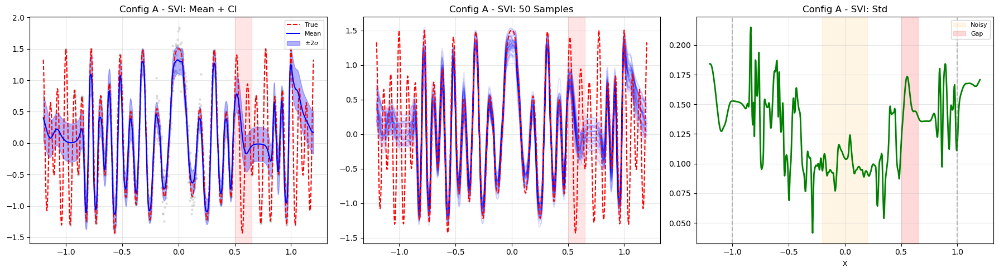

A-SVI 250 | 58.2:  17%|█▋        | 250/1500 [02:44<12:43,  1.64it/s]

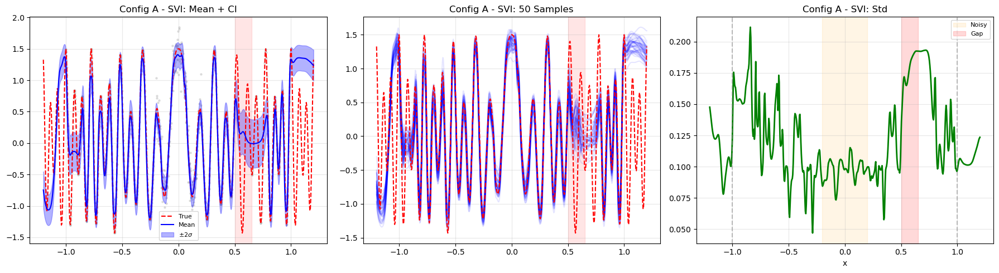

A-SVI 300 | 48.5:  20%|██        | 300/1500 [03:16<12:11,  1.64it/s]

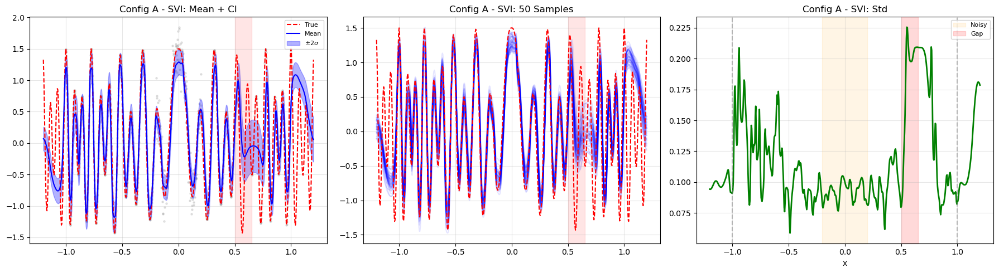

A-SVI 350 | 33.0:  23%|██▎       | 350/1500 [03:49<11:39,  1.64it/s]

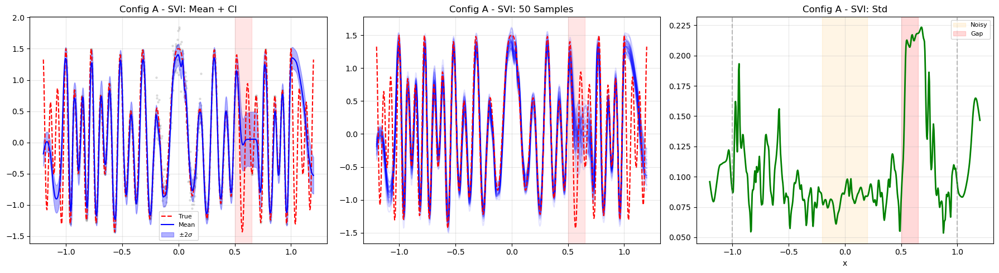

A-SVI 400 | 10.8:  27%|██▋       | 400/1500 [04:21<11:13,  1.63it/s]

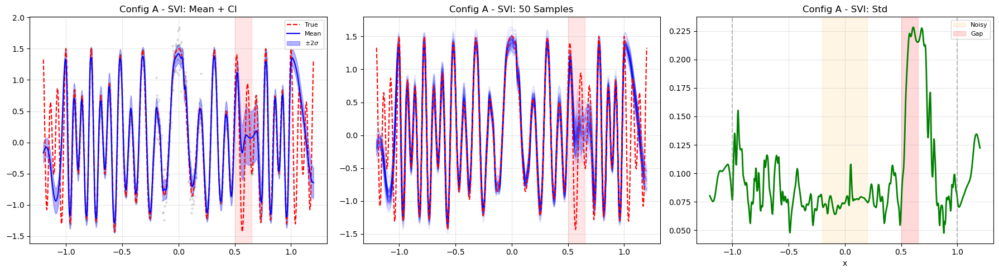

A-SVI 450 | 19.1:  30%|███       | 450/1500 [04:54<10:38,  1.65it/s]

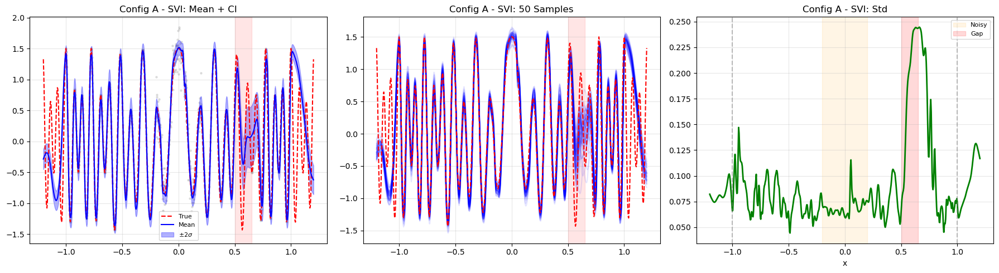

A-SVI 500 | -15.5:  33%|███▎      | 500/1500 [05:26<10:10,  1.64it/s]

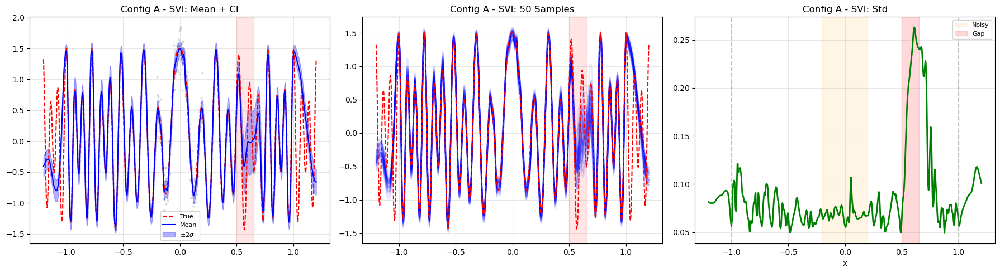

A-SVI 550 | -12.1:  37%|███▋      | 550/1500 [05:59<09:41,  1.63it/s]

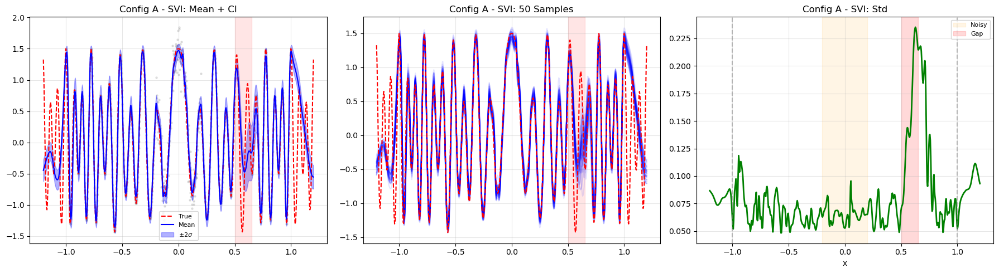

A-SVI 600 | -33.1:  40%|████      | 600/1500 [06:31<09:09,  1.64it/s]

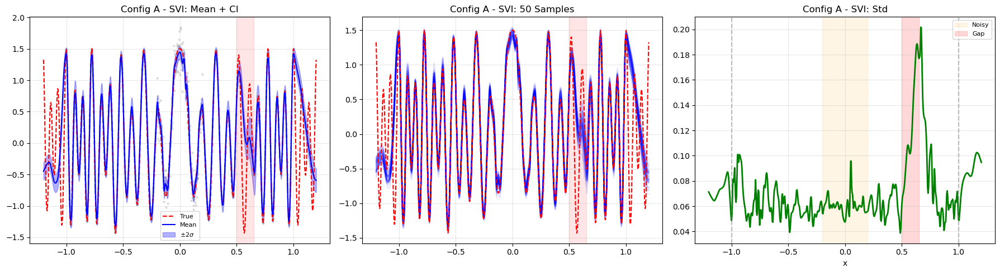

A-SVI 650 | -39.6:  43%|████▎     | 650/1500 [07:02<08:13,  1.72it/s]

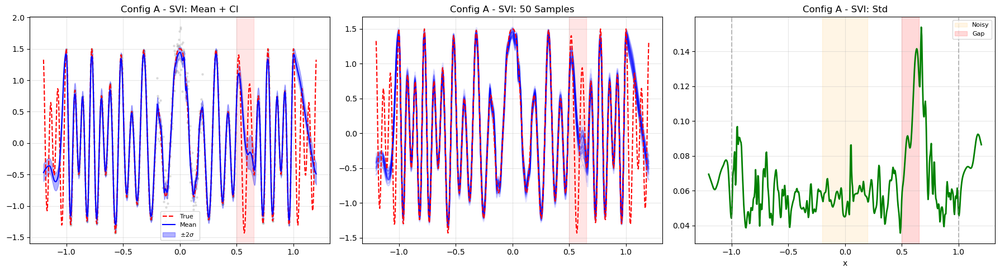

A-SVI 700 | -38.1:  47%|████▋     | 700/1500 [07:23<05:06,  2.61it/s]

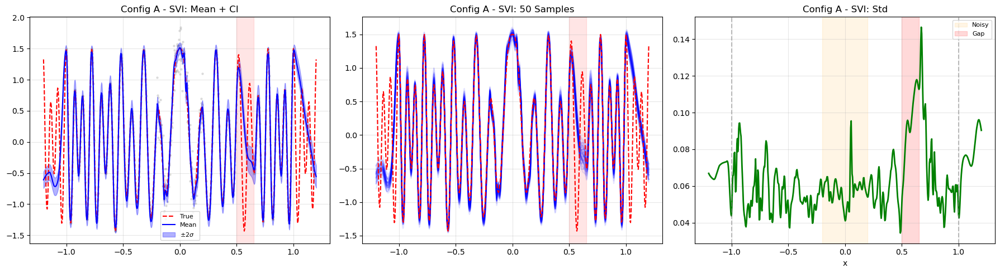

A-SVI 750 | -48.1:  50%|█████     | 750/1500 [07:44<04:47,  2.60it/s]

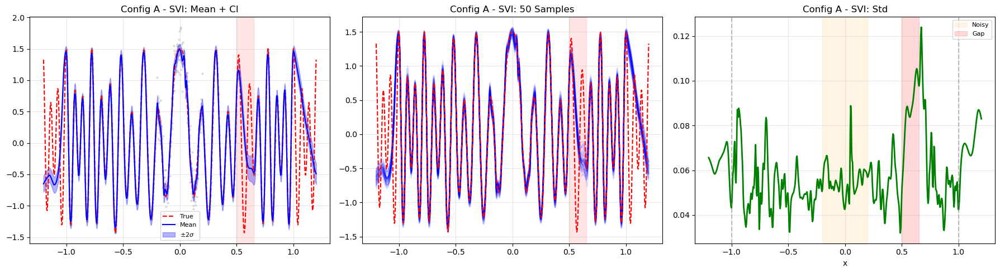

A-SVI 800 | -42.4:  53%|█████▎    | 800/1500 [08:05<04:27,  2.62it/s]

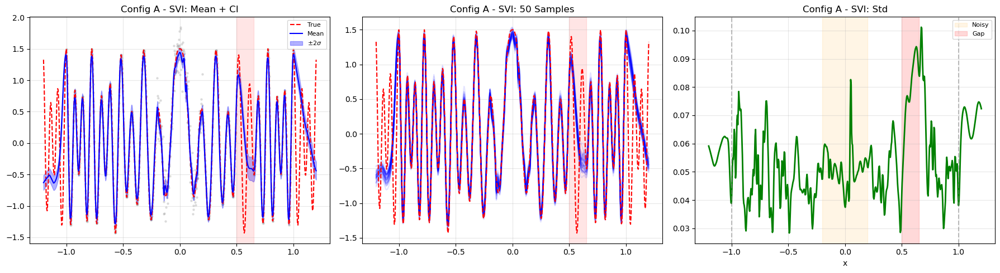

A-SVI 850 | -45.3:  57%|█████▋    | 850/1500 [08:27<04:10,  2.60it/s]

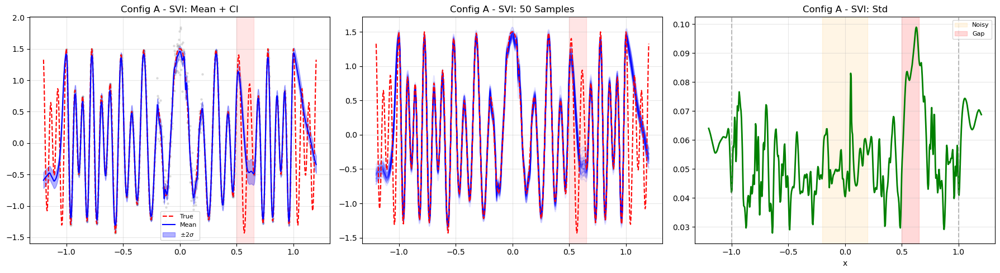

A-SVI 900 | -51.1:  60%|██████    | 900/1500 [08:48<03:51,  2.60it/s]

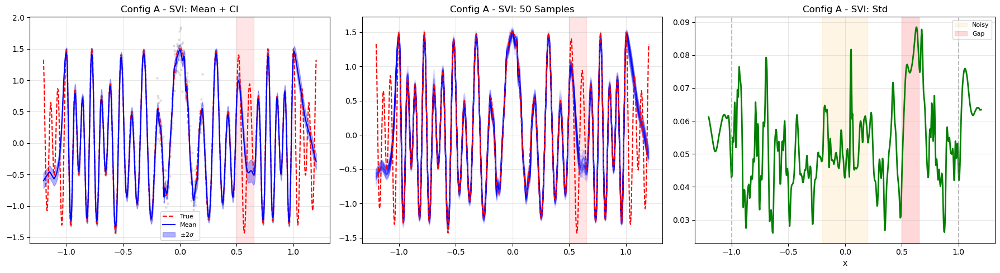

A-SVI 950 | -48.6:  63%|██████▎   | 950/1500 [09:09<03:29,  2.63it/s]

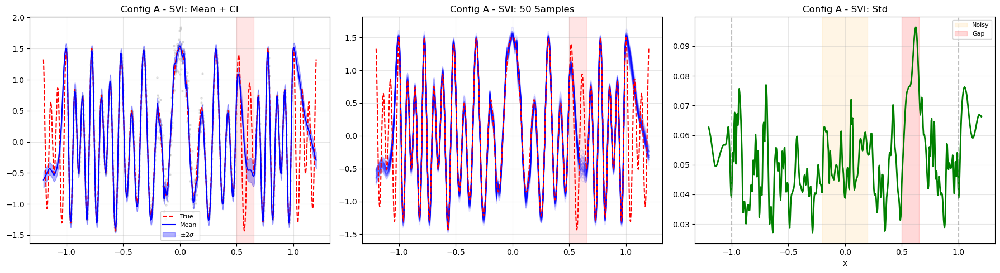

A-SVI 1000 | -50.3:  67%|██████▋   | 1000/1500 [09:30<03:11,  2.61it/s]

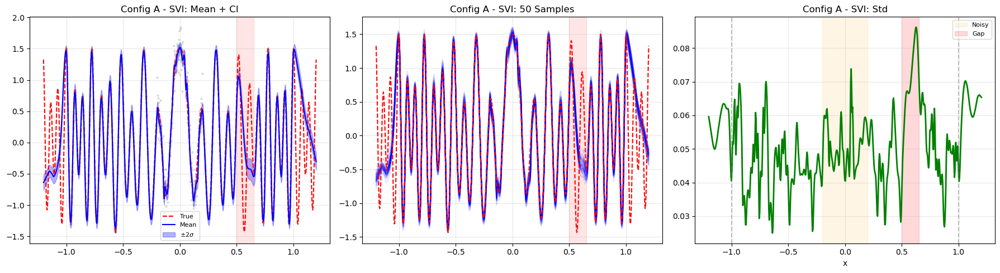

A-SVI 1050 | -58.0:  70%|███████   | 1050/1500 [09:51<02:53,  2.60it/s]

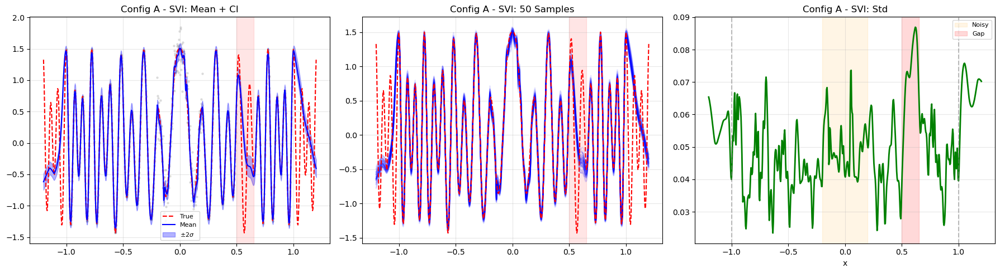

A-SVI 1100 | -49.7:  73%|███████▎  | 1100/1500 [10:13<02:34,  2.60it/s]

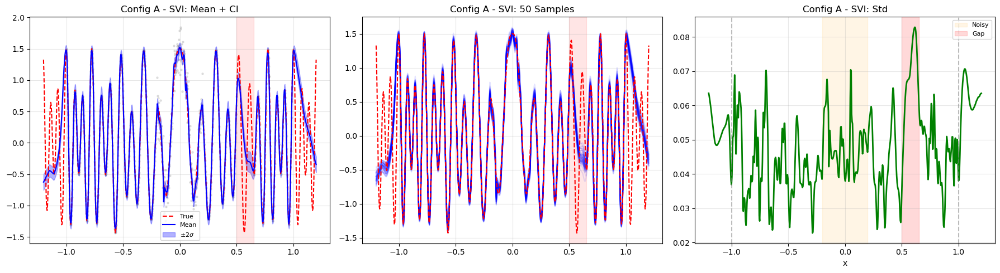

A-SVI 1150 | -63.3:  77%|███████▋  | 1150/1500 [10:34<02:15,  2.58it/s]

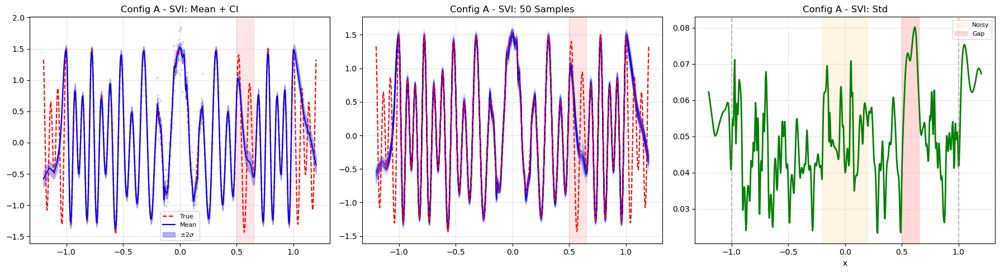

A-SVI 1200 | -59.9:  80%|████████  | 1200/1500 [10:55<01:56,  2.59it/s]

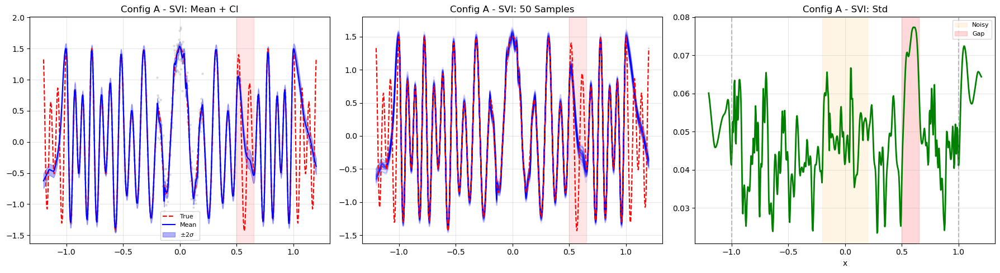

A-SVI 1250 | -58.3:  83%|████████▎ | 1250/1500 [11:17<01:37,  2.58it/s]

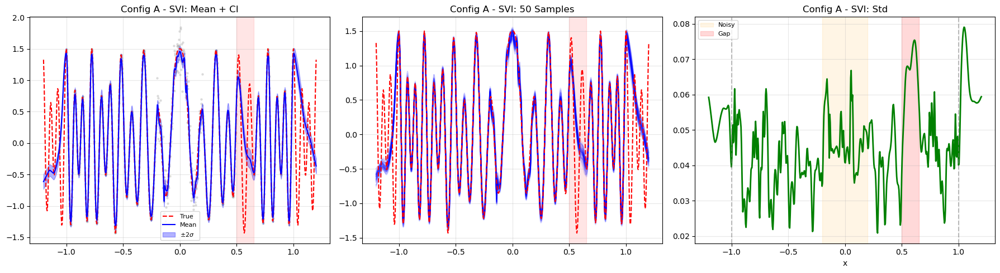

A-SVI 1300 | -68.3:  87%|████████▋ | 1300/1500 [11:38<01:11,  2.82it/s]

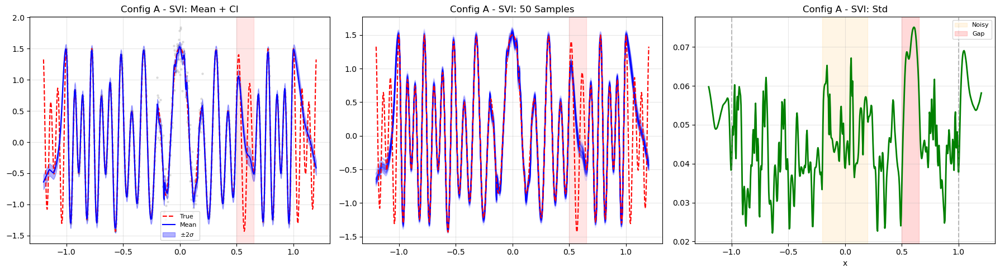

A-SVI 1350 | -59.8:  90%|█████████ | 1350/1500 [11:57<00:53,  2.81it/s]

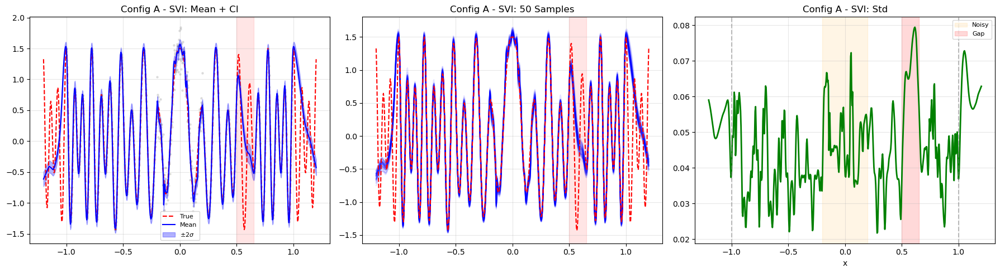

A-SVI 1400 | -66.6:  93%|█████████▎| 1400/1500 [12:16<00:35,  2.79it/s]

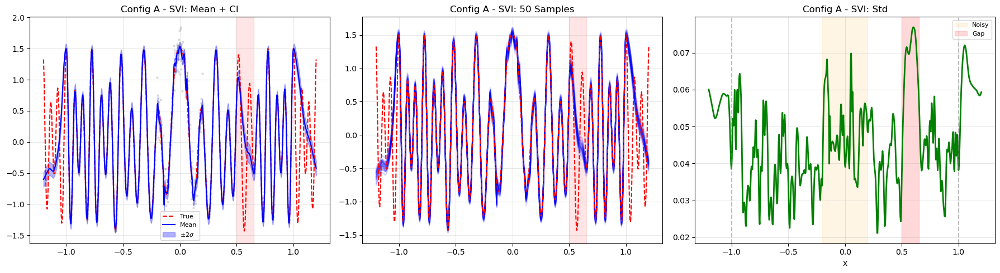

A-SVI 1450 | -68.3:  97%|█████████▋| 1450/1500 [12:36<00:17,  2.80it/s]

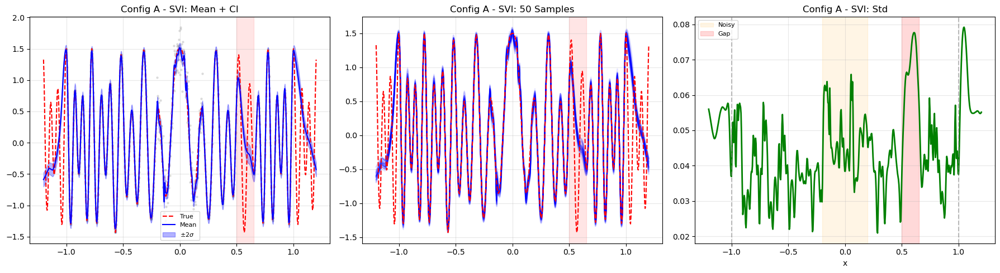

A-SVI 1450 | -68.3: 100%|██████████| 1500/1500 [12:56<00:00,  1.93it/s]


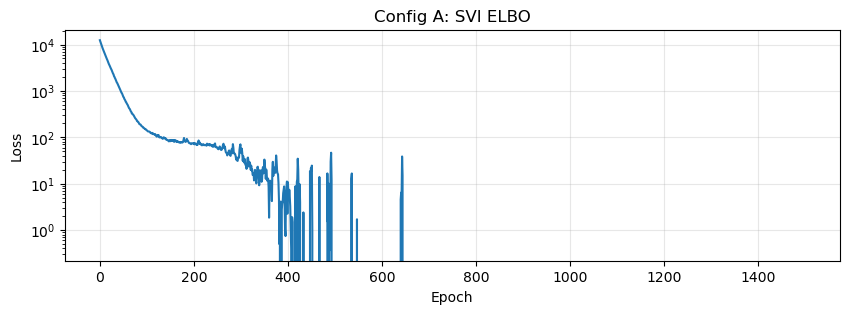

In [11]:
pyro.clear_param_store()

model_A_svi = BayesianMMNN_ConfigA(
    ranks=ranks, widths=widths, device=device,
    prior_scale=prior_scale, n_bayesian_layers=n_bayesian_layers,
    sigma_mode=sigma_mode_A, sigma_init=sigma_init
)

guide_A_svi = AutoDiagonalNormal(model_A_svi)
# optimizer_A = ClippedAdam({"lr": svi_lr, "lrd": svi_lrd})
optimizer_A = torch.optim.Adam
scheduler_A = ExponentialLR({"optimizer": optimizer_A, "optim_args":{'lr': svi_lr}, "gamma":svi_lrd})
svi_A = SVI(model_A_svi, guide_A_svi, scheduler_A, loss=Trace_ELBO(num_particles=3))

losses_A_svi = []
bar = tqdm(range(svi_epochs), desc="Config A SVI")
for epoch in bar:
    epoch_loss = 0.0
    for x_b, y_b in train_loader:
        epoch_loss += svi_A.step(x_b.squeeze(), y_b.squeeze())
    scheduler_A.step()
    losses_A_svi.append(epoch_loss / len(train_loader))
    if epoch % 50 == 0:
        bar.set_description(f"A-SVI {epoch} | {losses_A_svi[-1]:.1f}")
        model_A_svi.eval()
        pred_A_svi = Predictive(model_A_svi, guide=guide_A_svi, num_samples=500,
                                return_sites=("obs", "_RETURN"))
        with torch.no_grad():
            p = pred_A_svi(x_test.squeeze(), None)
        samples_A_svi_np = p["_RETURN"].detach().cpu().numpy()
        mean_A_svi = samples_A_svi_np.mean(axis=0)
        std_A_svi = samples_A_svi_np.std(axis=0)

        plot_predictions(mean_A_svi, std_A_svi, samples_A_svi_np, 'Config A - SVI')
        plt.tight_layout(); plt.show()
        model_A_svi.train()

plt.figure(figsize=(10, 3))
plt.plot(losses_A_svi); plt.title('Config A: SVI ELBO')
plt.xlabel('Epoch'); plt.ylabel('Loss'); plt.yscale('log'); plt.grid(True, alpha=0.3)
plt.show()

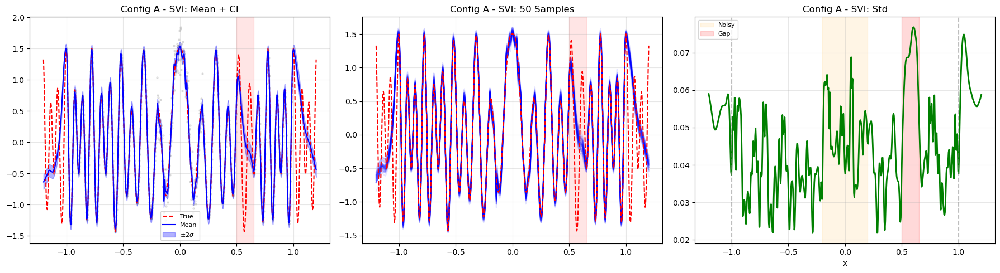

In [12]:
model_A_svi.eval()
pred_A_svi = Predictive(model_A_svi, guide=guide_A_svi, num_samples=500,
                        return_sites=("obs", "_RETURN"))
with torch.no_grad():
    p = pred_A_svi(x_test.squeeze(), None)
samples_A_svi_np = p["_RETURN"].detach().cpu().numpy()
mean_A_svi = samples_A_svi_np.mean(axis=0)
std_A_svi = samples_A_svi_np.std(axis=0)

plot_predictions(mean_A_svi, std_A_svi, samples_A_svi_np, 'Config A - SVI')
plt.tight_layout(); plt.show()

## Config B: SVI Training

Config B: Bayesian A,c perturbations in layers 4..5


B-SVI 0 | 6429.3:   0%|          | 0/1500 [00:00<?, ?it/s]

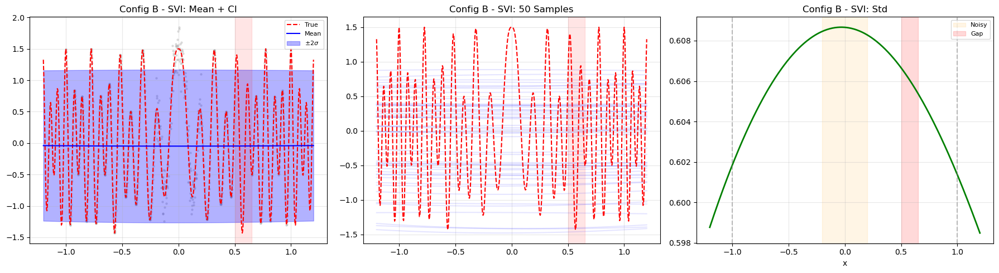

B-SVI 50 | 2067.0:   3%|▎         | 50/1500 [00:20<08:31,  2.83it/s]

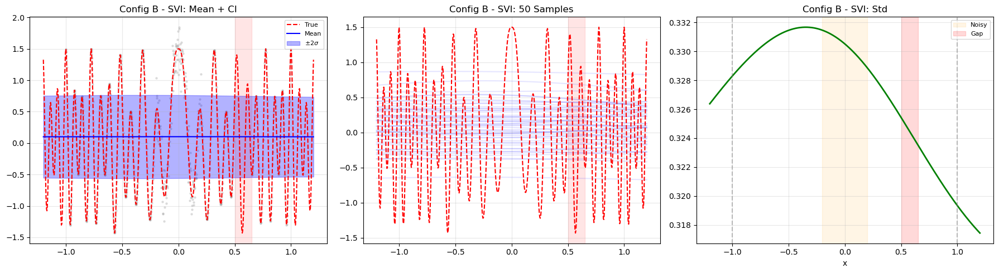

B-SVI 100 | 803.8:   7%|▋         | 100/1500 [00:39<08:09,  2.86it/s]

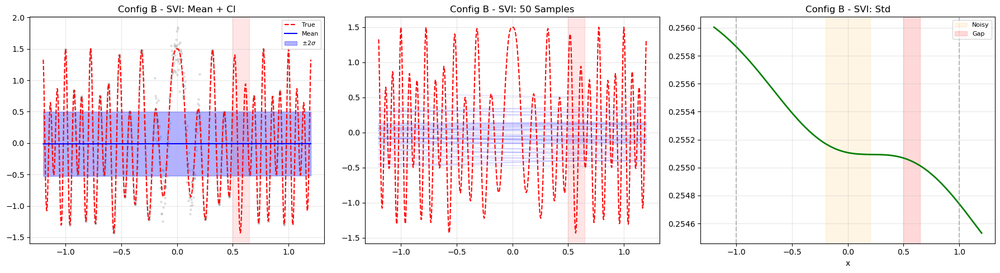

B-SVI 150 | 374.6:  10%|█         | 150/1500 [00:59<07:56,  2.84it/s]

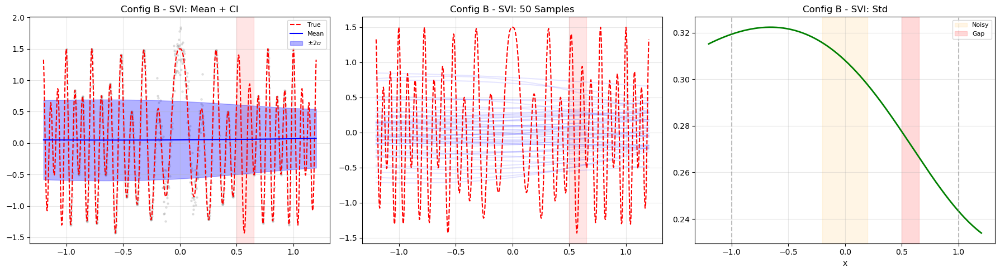

B-SVI 200 | 216.3:  13%|█▎        | 200/1500 [01:19<07:36,  2.85it/s]

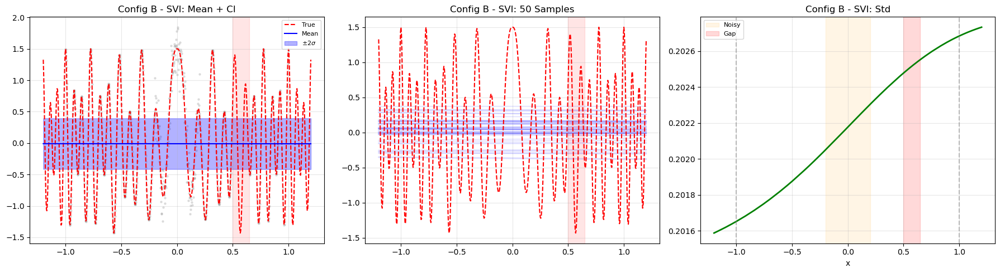

B-SVI 250 | 164.8:  17%|█▋        | 250/1500 [01:38<07:19,  2.84it/s]

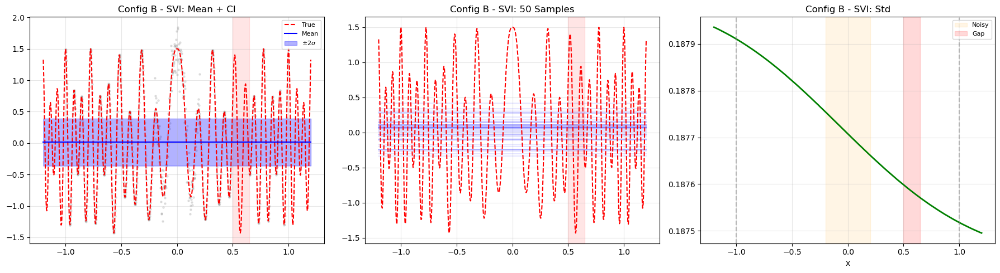

B-SVI 300 | 149.2:  20%|██        | 300/1500 [01:58<07:04,  2.83it/s]

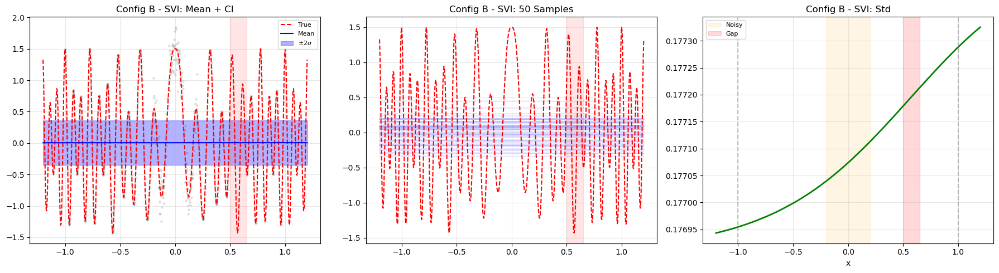

B-SVI 350 | 142.5:  23%|██▎       | 350/1500 [02:18<06:46,  2.83it/s]

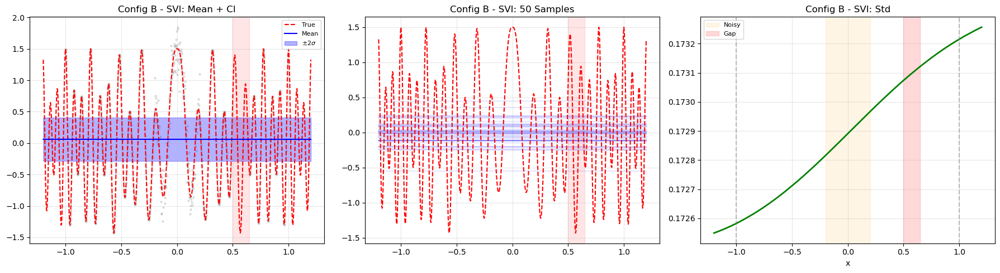

B-SVI 400 | 140.4:  27%|██▋       | 400/1500 [02:38<06:30,  2.82it/s]

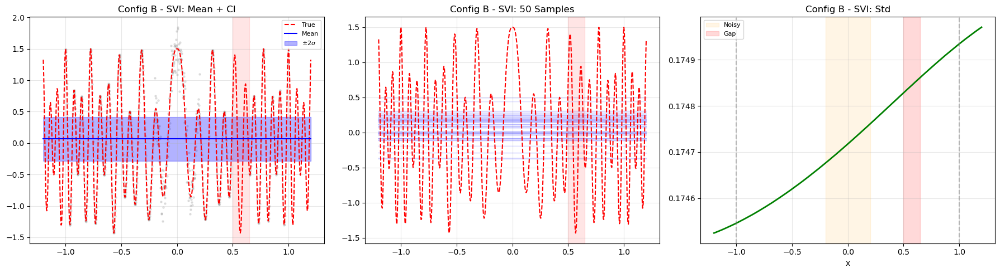

B-SVI 450 | 142.5:  30%|███       | 450/1500 [02:57<06:09,  2.84it/s]

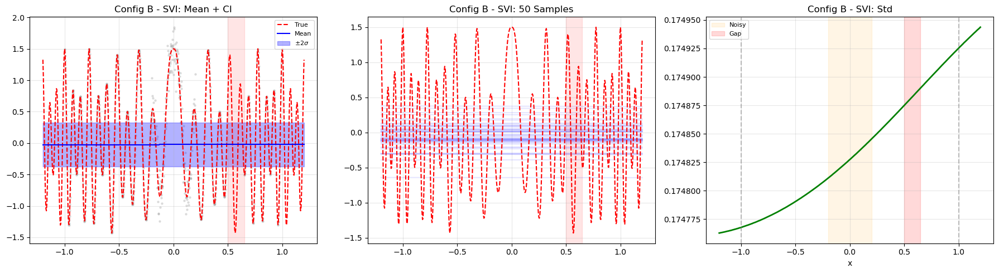

B-SVI 500 | 139.6:  33%|███▎      | 500/1500 [03:17<05:52,  2.83it/s]

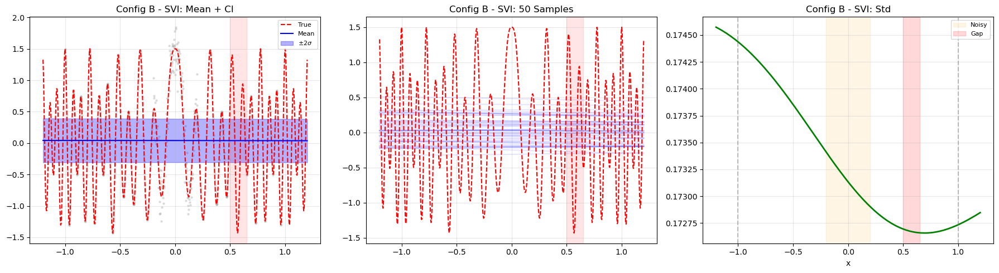

B-SVI 550 | 140.1:  37%|███▋      | 550/1500 [03:37<05:36,  2.83it/s]

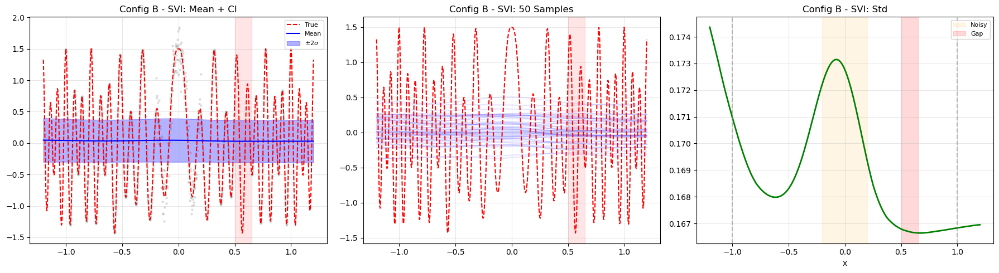

B-SVI 600 | 129.5:  40%|████      | 600/1500 [03:57<05:17,  2.83it/s]

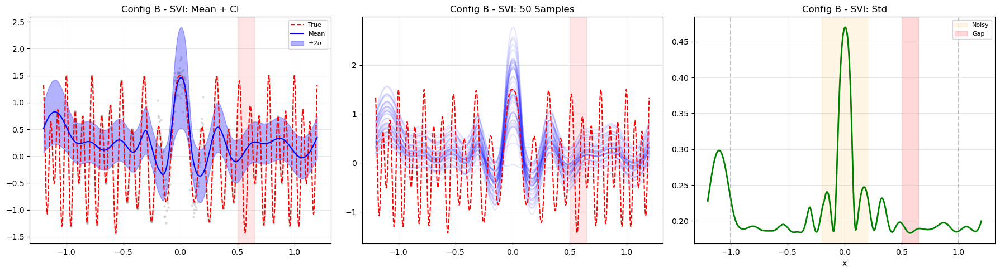

B-SVI 650 | 103.2:  43%|████▎     | 650/1500 [04:17<04:59,  2.83it/s]

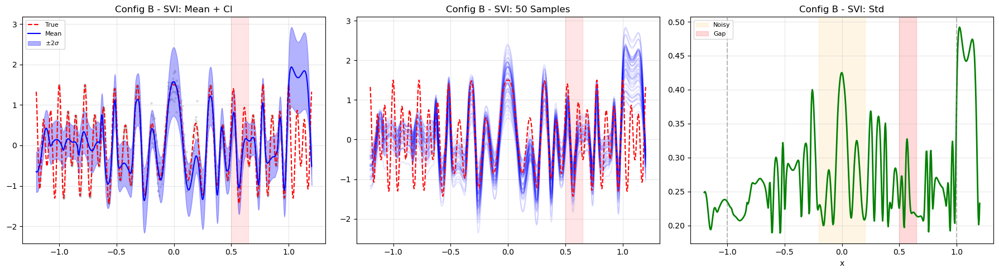

B-SVI 700 | 66.4:  47%|████▋     | 700/1500 [04:36<04:41,  2.84it/s] 

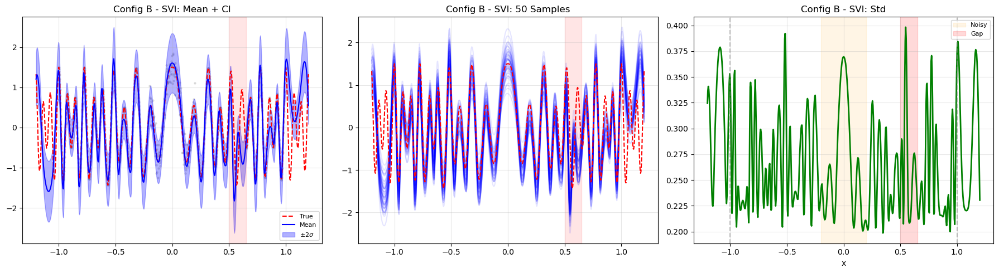

B-SVI 750 | 50.9:  50%|█████     | 750/1500 [04:56<04:25,  2.83it/s]

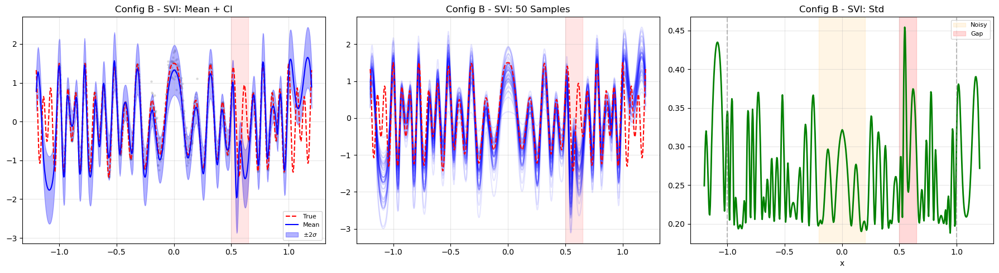

B-SVI 800 | 49.9:  53%|█████▎    | 800/1500 [05:16<04:06,  2.84it/s]

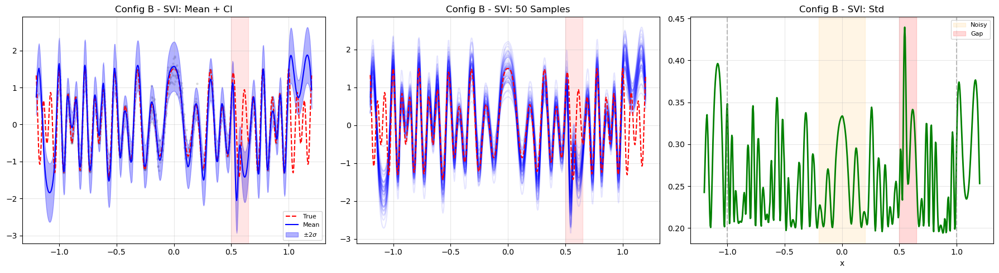

B-SVI 850 | 43.6:  57%|█████▋    | 850/1500 [05:36<03:49,  2.83it/s]

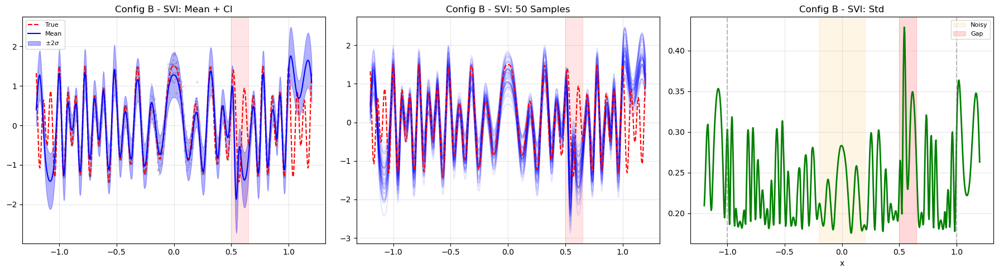

B-SVI 900 | 35.8:  60%|██████    | 900/1500 [05:55<03:28,  2.88it/s]

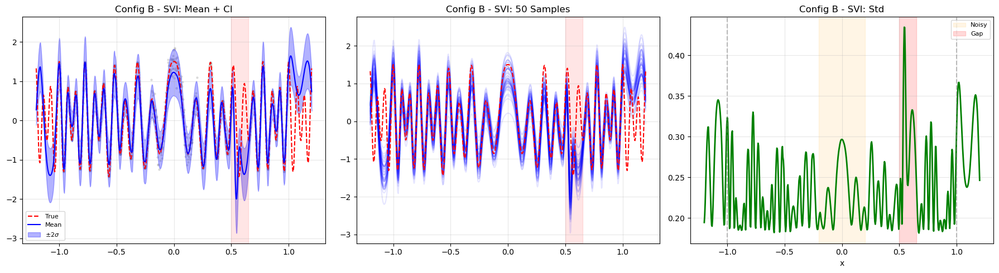

B-SVI 950 | 25.4:  63%|██████▎   | 950/1500 [06:15<03:13,  2.84it/s]

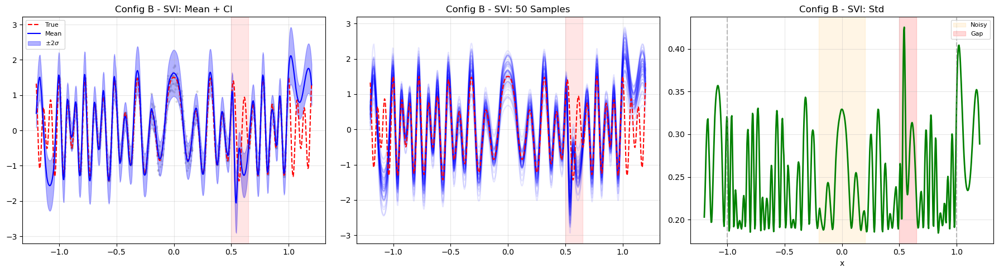

B-SVI 1000 | 38.2:  67%|██████▋   | 1000/1500 [06:35<02:55,  2.86it/s]

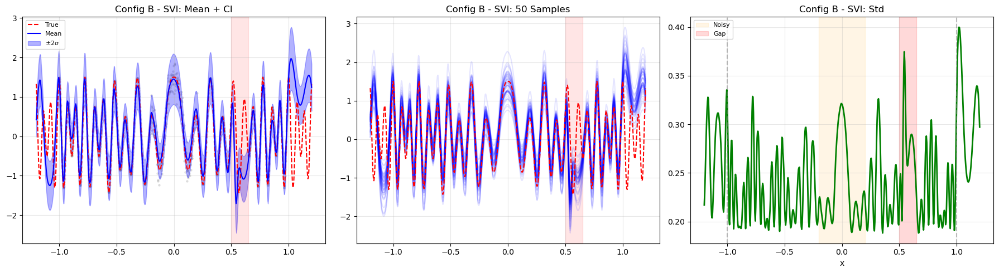

B-SVI 1050 | 6.5:  70%|███████   | 1050/1500 [06:55<02:39,  2.82it/s] 

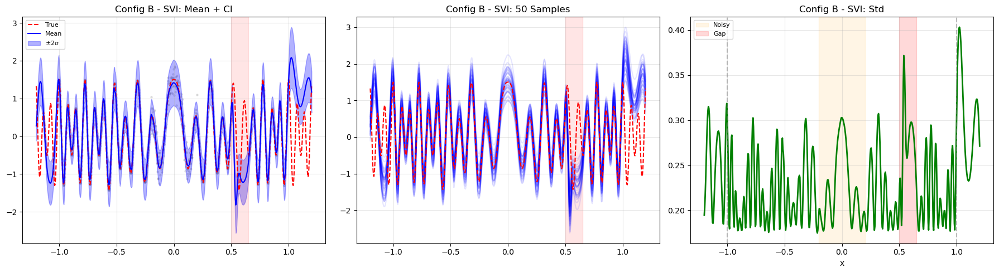

B-SVI 1100 | 25.8:  73%|███████▎  | 1100/1500 [07:14<02:20,  2.84it/s]

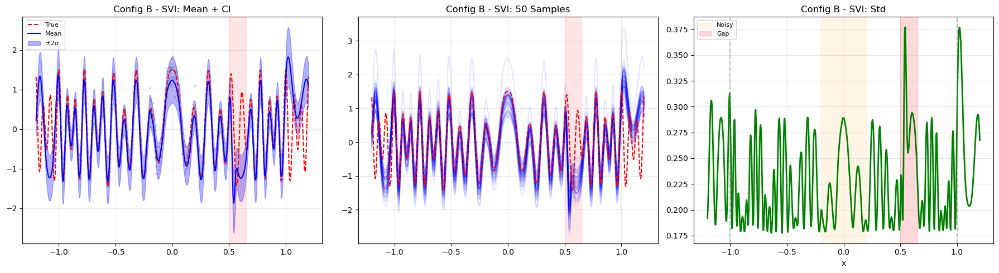

B-SVI 1150 | 31.2:  77%|███████▋  | 1150/1500 [07:34<02:03,  2.83it/s]

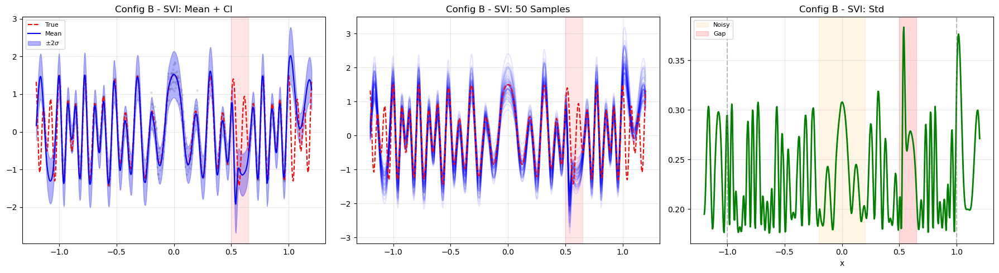

B-SVI 1200 | 18.9:  80%|████████  | 1200/1500 [07:54<01:46,  2.82it/s]

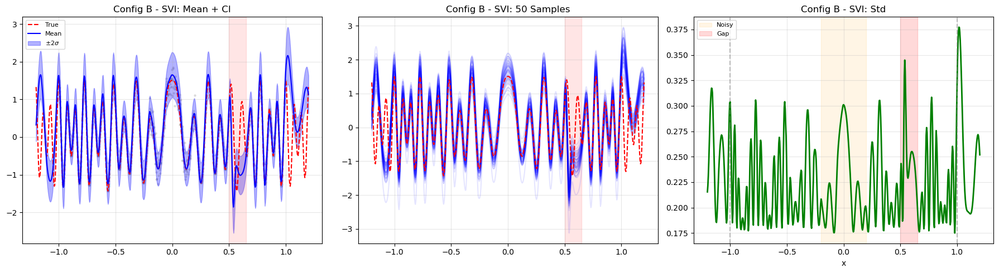

B-SVI 1250 | 26.3:  83%|████████▎ | 1250/1500 [08:14<01:28,  2.84it/s]

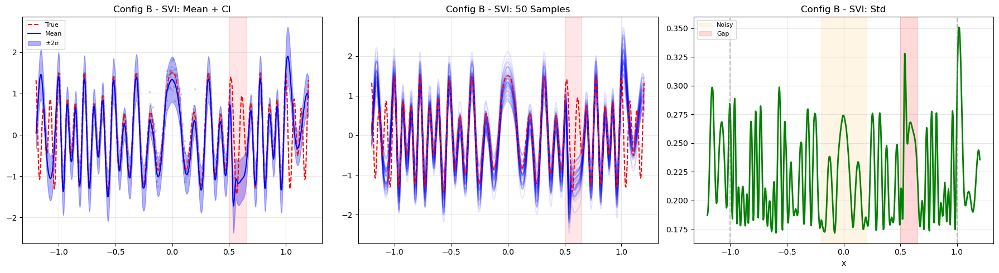

B-SVI 1300 | 22.7:  87%|████████▋ | 1300/1500 [08:34<01:10,  2.84it/s]

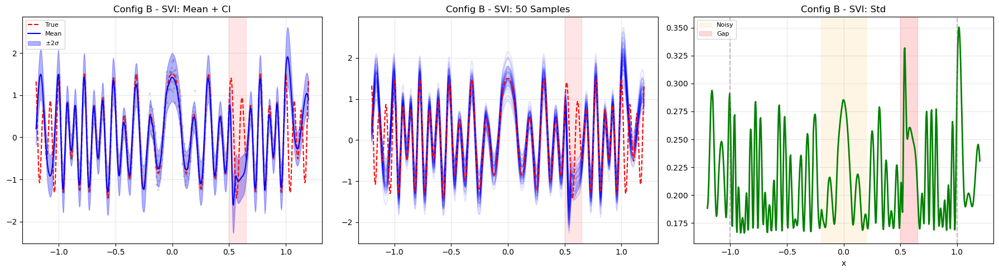

B-SVI 1350 | 18.9:  90%|█████████ | 1350/1500 [08:53<00:52,  2.85it/s]

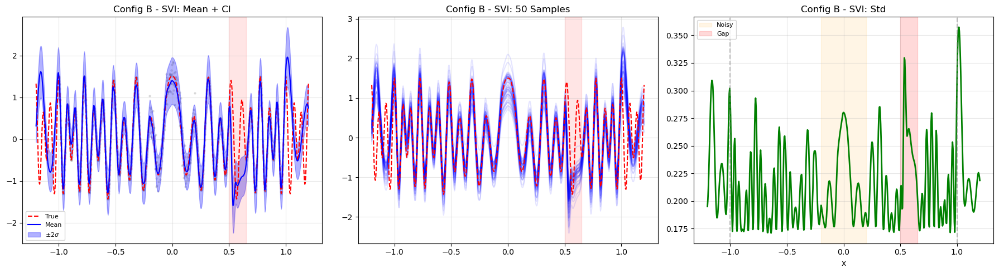

B-SVI 1400 | 21.1:  93%|█████████▎| 1400/1500 [09:13<00:35,  2.84it/s]

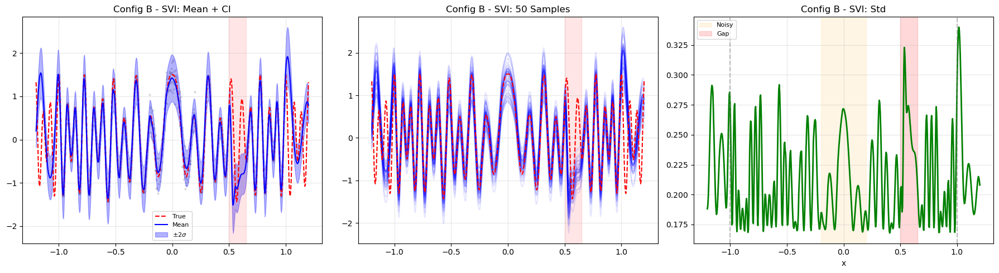

B-SVI 1450 | 23.8:  97%|█████████▋| 1450/1500 [09:32<00:17,  2.86it/s]

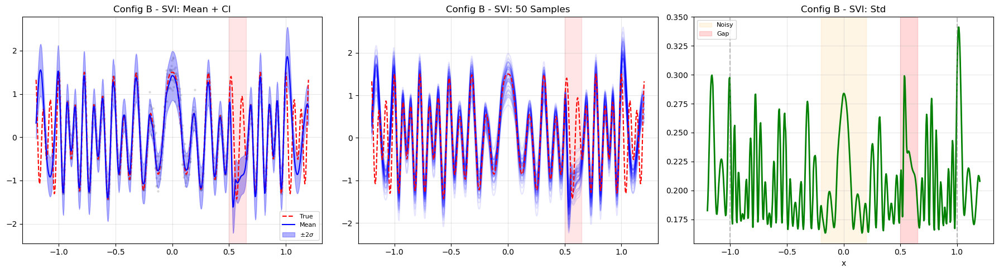

B-SVI 1450 | 23.8: 100%|██████████| 1500/1500 [09:52<00:00,  2.53it/s]


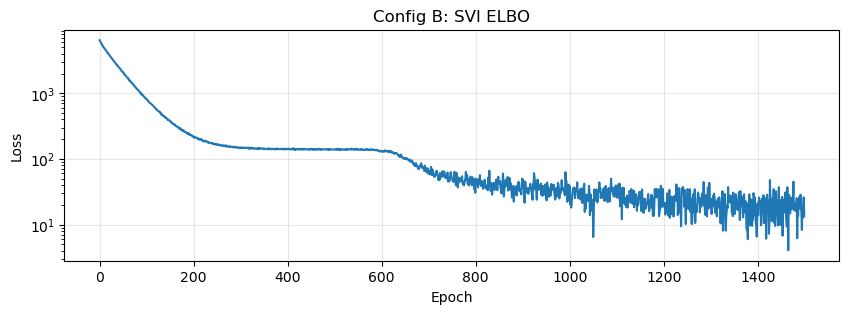

In [13]:
pyro.clear_param_store()

model_B_svi = BayesianMMNN_ConfigB(
    ranks=ranks, widths=widths, device=device,
    prior_scale=prior_scale, n_bayesian_layers=n_bayesian_layers,
    sigma_mode=sigma_mode_B, sigma_init=sigma_init
)

guide_B_svi = AutoDiagonalNormal(model_B_svi)
# optimizer_B = ClippedAdam({"lr": svi_lr, "lrd": svi_lrd})
optimizer_B = torch.optim.Adam
scheduler_B = ExponentialLR({"optimizer": optimizer_B, "optim_args":{'lr': svi_lr}, "gamma":svi_lrd})
svi_B = SVI(model_B_svi, guide_B_svi, scheduler_B, loss=Trace_ELBO(num_particles=3))

losses_B_svi = []
bar = tqdm(range(svi_epochs), desc="Config B SVI")
for epoch in bar:
    epoch_loss = 0.0
    for x_b, y_b in train_loader:
        epoch_loss += svi_B.step(x_b.squeeze(), y_b.squeeze())
    losses_B_svi.append(epoch_loss / len(train_loader))
    scheduler_B.step()
    if epoch % 50 == 0:
        bar.set_description(f"B-SVI {epoch} | {losses_B_svi[-1]:.1f}")
        model_B_svi.eval()
        pred_B_svi = Predictive(model_B_svi, guide=guide_B_svi, num_samples=500,
                                return_sites=("obs", "_RETURN"))
        with torch.no_grad():
            p = pred_B_svi(x_test.squeeze(), None)
        samples_B_svi_np = p["_RETURN"].detach().cpu().numpy()
        mean_B_svi = samples_B_svi_np.mean(axis=0)
        std_B_svi = samples_B_svi_np.std(axis=0)

        plot_predictions(mean_B_svi, std_B_svi, samples_B_svi_np, 'Config B - SVI')
        plt.tight_layout(); plt.show()
        model_B_svi.train()

plt.figure(figsize=(10, 3))
plt.plot(losses_B_svi); plt.title('Config B: SVI ELBO')
plt.xlabel('Epoch'); plt.ylabel('Loss'); plt.yscale('log'); plt.grid(True, alpha=0.3)
plt.show()

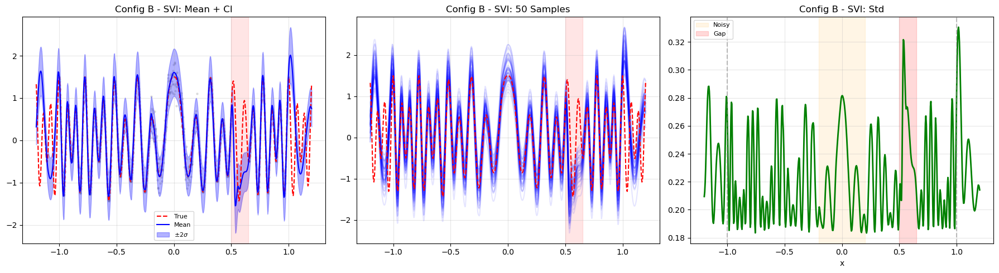

In [14]:
model_B_svi.eval()
pred_B_svi = Predictive(model_B_svi, guide=guide_B_svi, num_samples=500,
                        return_sites=("obs", "_RETURN"))
with torch.no_grad():
    p = pred_B_svi(x_test.squeeze(), None)
samples_B_svi_np = p["_RETURN"].detach().cpu().numpy()
mean_B_svi = samples_B_svi_np.mean(axis=0)

std_B_svi = samples_B_svi_np.std(axis=0)

plot_predictions(mean_B_svi, std_B_svi, samples_B_svi_np, 'Config B - SVI')
plt.tight_layout(); plt.show()

## Config A: NUTS Training

In [27]:
pyro.clear_param_store()

model_A_nuts = BayesianMMNN_ConfigA(
    ranks=ranks, widths=widths, device=device,
    prior_scale=prior_scale_nuts, n_bayesian_layers=n_bayesian_layers,
    sigma_mode=sigma_mode_A_nuts, sigma_init=sigma_init
)

mcmc_A = MCMC(
    NUTS(model_A_nuts, jit_compile=False, step_size=0.01,
         adapt_step_size=True, adapt_mass_matrix=True,
         max_tree_depth=10, target_accept_prob=0.8),
    num_samples=nuts_samples, warmup_steps=nuts_warmup,
    num_chains=1, disable_progbar=False
)

print("Config A NUTS...")
mcmc_A.run(x_train.squeeze(), y_train.squeeze())
posterior_A_nuts = mcmc_A.get_samples()
mcmc_A.summary()

Config A: Bayesian W,b in layers 4..5
Config A NUTS...


Warmup:   0%|          | 0/800 [00:00, ?it/s]

Sample: 100%|██████████| 800/800 [21:15,  1.59s/it, step size=1.42e-02, acc. prob=0.848]



                 mean       std    median      5.0%     95.0%     n_eff     r_hat
   W_4[0,0]      0.09      1.04      0.06     -1.49      1.88    423.25      1.00
   W_4[0,1]     -0.05      1.04     -0.13     -1.52      1.75    390.63      1.00
   W_4[0,2]     -0.23      0.99     -0.30     -1.71      1.62    247.50      1.01
   W_4[0,3]     -0.15      1.06     -0.17     -1.90      1.42    374.96      1.00
   W_4[0,4]      0.18      1.05      0.21     -1.75      1.68    455.33      1.00
   W_4[0,5]      0.20      0.96      0.19     -1.22      1.83    387.97      1.00
   W_4[0,6]     -0.15      0.97     -0.19     -1.60      1.56    393.17      1.00
   W_4[0,7]      0.09      0.96      0.12     -1.44      1.65    490.93      1.00
   W_4[0,8]      0.23      1.05      0.24     -1.48      2.05    313.45      1.00
   W_4[0,9]      0.07      1.03      0.12     -1.63      1.71    311.99      1.00
  W_4[0,10]      0.19      0.93      0.22     -1.18      1.78    403.79      1.00
  W_4[0,11]    

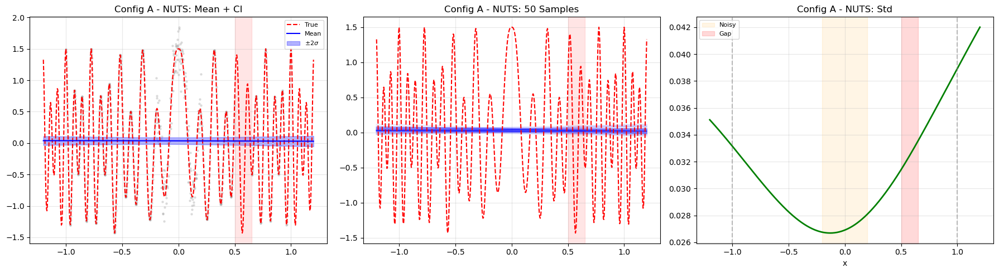

In [38]:
pred_A_nuts_fn = Predictive(model_A_nuts, posterior_samples=posterior_A_nuts,
                            return_sites=["obs", "_RETURN"])
with torch.no_grad():
    p = pred_A_nuts_fn(x_test.squeeze(), None)
samples_A_nuts_np = p["_RETURN"].detach().cpu().numpy()
mean_A_nuts = samples_A_nuts_np.mean(axis=0)
std_A_nuts = samples_A_nuts_np.std(axis=0)

plot_predictions(mean_A_nuts, std_A_nuts, samples_A_nuts_np, 'Config A - NUTS')
plt.tight_layout(); plt.show()

## Config B: NUTS Training

In [29]:
pyro.clear_param_store()

model_B_nuts = BayesianMMNN_ConfigB(
    ranks=ranks, widths=widths, device=device,
    prior_scale=prior_scale_nuts, n_bayesian_layers=n_bayesian_layers,
    sigma_mode=sigma_mode_B_nuts, sigma_init=sigma_init
)

mcmc_B = MCMC(
    NUTS(model_B_nuts, jit_compile=False, step_size=0.01,
         adapt_step_size=True, adapt_mass_matrix=True,
         max_tree_depth=10, target_accept_prob=0.8),
    num_samples=nuts_samples, warmup_steps=nuts_warmup,
    num_chains=1, disable_progbar=False
)

print("Config B NUTS...")
mcmc_B.run(x_train.squeeze(), y_train.squeeze())
posterior_B_nuts = mcmc_B.get_samples()
mcmc_B.summary()

Config B: Bayesian A,c perturbations in layers 4..5
Config B NUTS...


Sample: 100%|██████████| 800/800 [1:13:13,  5.49s/it, step size=1.05e-03, acc. prob=0.903]



                  mean       std    median      5.0%     95.0%     n_eff     r_hat
   dA_4[0,0]     -0.13      0.88     -0.19     -1.54      1.31     33.53      1.00
   dA_4[0,1]      0.11      0.99      0.05     -1.46      1.77     48.32      1.00
   dA_4[0,2]     -0.12      0.82     -0.15     -1.55      1.19     58.17      1.04
   dA_4[0,3]     -0.14      1.02     -0.06     -1.98      1.25     34.88      1.00
   dA_4[0,4]      0.05      1.03      0.05     -1.85      1.45     29.99      1.03
   dA_4[0,5]     -0.06      0.99     -0.08     -1.59      1.60     46.74      1.01
   dA_4[0,6]     -0.17      1.19     -0.15     -2.11      1.73     32.28      1.00
   dA_4[0,7]     -0.26      0.90     -0.36     -1.75      1.13     30.24      1.00
   dA_4[0,8]      0.07      1.03      0.09     -1.54      1.62     51.81      1.01
   dA_4[0,9]     -0.05      1.03     -0.09     -1.73      1.73     20.88      1.06
  dA_4[0,10]      0.14      0.80      0.11     -1.00      1.63     44.19      1.01
  d

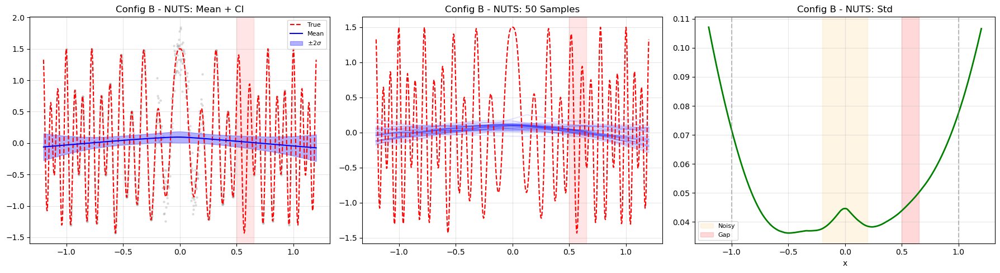

In [39]:
pred_B_nuts_fn = Predictive(model_B_nuts, posterior_samples=posterior_B_nuts,
                            return_sites=["obs", "_RETURN"])
with torch.no_grad():
    p = pred_B_nuts_fn(x_test.squeeze(), None)
samples_B_nuts_np = p["_RETURN"].detach().cpu().numpy()
mean_B_nuts = samples_B_nuts_np.mean(axis=0)
std_B_nuts = samples_B_nuts_np.std(axis=0)

plot_predictions(mean_B_nuts, std_B_nuts, samples_B_nuts_np, 'Config B - NUTS')
plt.tight_layout(); plt.show()

## Custom HMC: Config A vs Config B

In [31]:
model_A_hmc = MMNN_ConfigA_HMC(
    ranks=ranks, widths=widths, device=device,
    prior_var=prior_scale**2, n_bayesian_layers=n_bayesian_layers
)

samples_A_hmc, potential_A = run_hmc(
    model_A_hmc, x_train, y_train,
    num_samples=hmc_samples, burn_in=hmc_burn_in,
    step_size=hmc_step_size, num_steps=hmc_leapfrog_steps,
    noise_std=noise_std_fixed, device=device
)

Config A HMC: Bayesian W,b params: 14744 | MAP A,c params: 35399 | total: 73035


HMC: 100%|██████████| 1000/1000 [03:45<00:00,  4.43it/s, U=33109.6, Acc=0.12]

Collected 600 samples. Acceptance: 11.70%


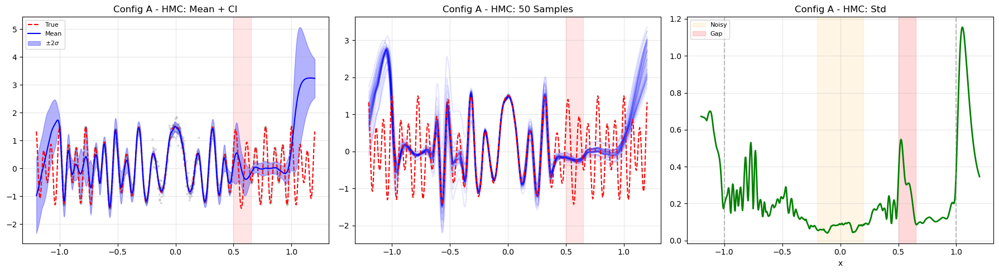

In [32]:
stack_A_hmc, mean_A_hmc_t, std_A_hmc_t, _, _ = predict_hmc(model_A_hmc, samples_A_hmc, x_test)
mean_A_hmc = mean_A_hmc_t.cpu().numpy().flatten()
std_A_hmc = std_A_hmc_t.cpu().numpy().flatten()
samples_A_hmc_np = stack_A_hmc.cpu().numpy().squeeze()

plot_predictions(mean_A_hmc, std_A_hmc, samples_A_hmc_np, 'Config A - HMC')
plt.tight_layout(); plt.show()

In [33]:
model_B_hmc = MMNN_ConfigB_HMC(
    ranks=ranks, widths=widths, device=device,
    prior_var=prior_scale**2, n_bayesian_layers=n_bayesian_layers
)

samples_B_hmc, potential_B = run_hmc(
    model_B_hmc, x_train, y_train,
    num_samples=hmc_samples, burn_in=hmc_burn_in,
    step_size=hmc_step_size, num_steps=hmc_leapfrog_steps,
    noise_std=noise_std_fixed, device=device
)

Config B HMC: Bayesian dA,dc params: 7391 | MAP A,c params: 35399 | total: 80426


HMC: 100%|██████████| 1000/1000 [01:35<00:00, 10.45it/s, U=6309.2, Acc=0.01] 


Collected 600 samples. Acceptance: 1.10%


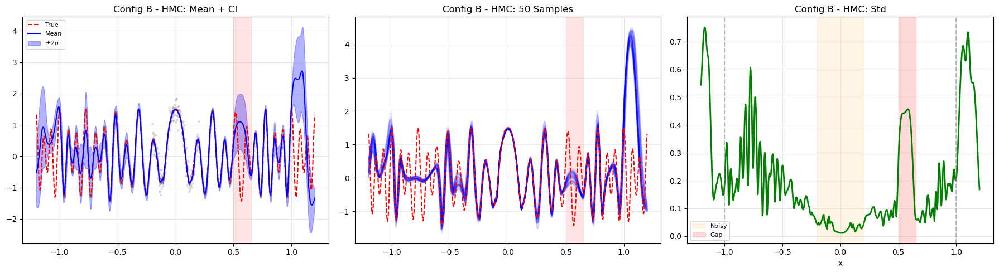

In [34]:
stack_B_hmc, mean_B_hmc_t, std_B_hmc_t, _, _ = predict_hmc(model_B_hmc, samples_B_hmc, x_test)
mean_B_hmc = mean_B_hmc_t.cpu().numpy().flatten()
std_B_hmc = std_B_hmc_t.cpu().numpy().flatten()
samples_B_hmc_np = stack_B_hmc.cpu().numpy().squeeze()

plot_predictions(mean_B_hmc, std_B_hmc, samples_B_hmc_np, 'Config B - HMC')
plt.tight_layout(); plt.show()

## Comparison: Config A vs Config B

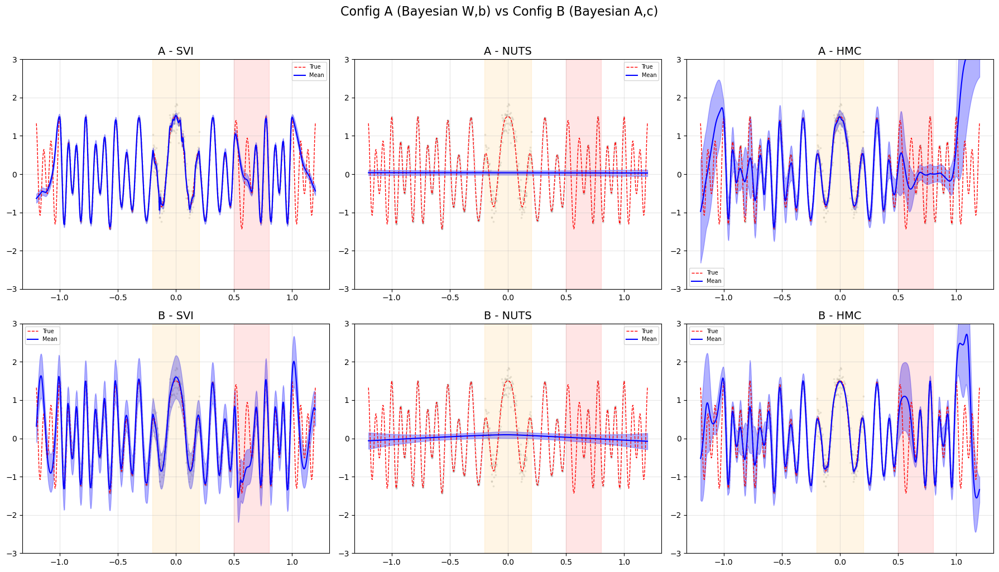

In [35]:
# ============================================================================
# Uncertainty comparison: all 6 methods
# ============================================================================

fig, axes = plt.subplots(2, 3, figsize=(18, 10))

all_methods = [
    ('A - SVI',  mean_A_svi,  std_A_svi),
    ('A - NUTS', mean_A_nuts, std_A_nuts),
    ('A - HMC',  mean_A_hmc,  std_A_hmc),
    ('B - SVI',  mean_B_svi,  std_B_svi),
    ('B - NUTS', mean_B_nuts, std_B_nuts),
    ('B - HMC',  mean_B_hmc,  std_B_hmc),
]

for idx, (name, mean, std) in enumerate(all_methods):
    ax = axes[idx // 3, idx % 3]
    ax.scatter(x_train.cpu(), y_train.cpu(), s=3, alpha=0.15, c='gray')
    ax.plot(x_np, y_true_np, 'r--', lw=1, label='True')
    ax.plot(x_np, mean, 'b-', lw=1.5, label='Mean')
    ax.fill_between(x_np, mean - 2*std, mean + 2*std,
                   alpha=0.3, color='blue')
    ax.axvspan(0.5, 0.8, alpha=0.1, color='red')
    ax.axvspan(-0.2, 0.2, alpha=0.1, color='orange')
    ax.set_title(name, fontsize=14)
    ax.legend(fontsize=7); ax.grid(True, alpha=0.3)
    ax.set_ylim(-3, 3)

plt.suptitle('Config A (Bayesian W,b) vs Config B (Bayesian A,c)', fontsize=16, y=1.02)
plt.tight_layout()
plt.show()

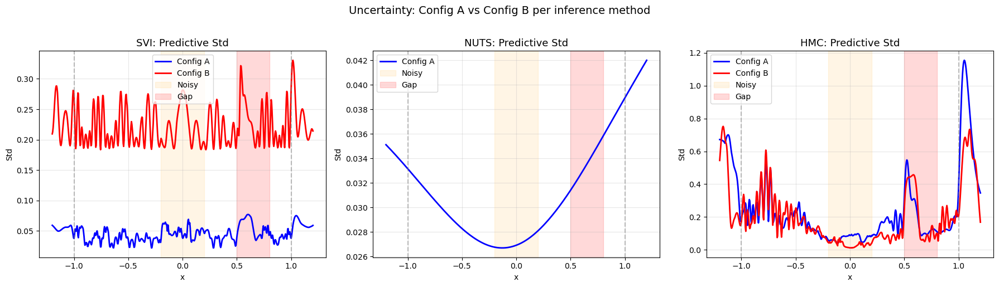

In [36]:
# ============================================================================
# Std comparison
# ============================================================================

fig, axes = plt.subplots(1, 3, figsize=(18, 5))

for ax, method_name in zip(axes, ['SVI', 'NUTS', 'HMC']): #, 'NUTS', 'HMC'
    if method_name == 'SVI':
        ax.plot(x_np, std_A_svi, 'b-', lw=2, label='Config A')
        ax.plot(x_np, std_B_svi, 'r-', lw=2, label='Config B')
    elif method_name == 'NUTS':
        ax.plot(x_np, std_A_nuts, 'b-', lw=2, label='Config A')
        # ax.plot(x_np, std_B_nuts, 'r-', lw=2, label='Config B')
    else:
        ax.plot(x_np, std_A_hmc, 'b-', lw=2, label='Config A')
        ax.plot(x_np, std_B_hmc, 'r-', lw=2, label='Config B')
    
    ax.axvspan(-0.2, 0.2, alpha=0.1, color='orange', label='Noisy')
    ax.axvspan(0.5, 0.8, alpha=0.15, color='red', label='Gap')
    ax.axvline(-1, color='gray', ls='--', alpha=0.5)
    ax.axvline(1, color='gray', ls='--', alpha=0.5)
    ax.set_title(f'{method_name}: Predictive Std', fontsize=13)
    ax.set_xlabel('x'); ax.set_ylabel('Std')
    ax.legend(); ax.grid(True, alpha=0.3)

plt.suptitle('Uncertainty: Config A vs Config B per inference method', fontsize=14, y=1.02)
plt.tight_layout()
plt.show()

In [37]:
# ============================================================================
# Metrics Comparison
# ============================================================================

def compute_metrics(pred_samples_np, y_true_np):
    mean = pred_samples_np.mean(axis=0)
    std = pred_samples_np.std(axis=0)
    rmse = np.sqrt(np.mean((mean - y_true_np)**2))
    nll = 0.5 * np.mean(np.log(std**2 + 1e-6) + (y_true_np - mean)**2 / (std**2 + 1e-6))
    lower = np.percentile(pred_samples_np, 5, axis=0)
    upper = np.percentile(pred_samples_np, 95, axis=0)
    coverage = np.mean((y_true_np >= lower) & (y_true_np <= upper))
    interval = np.mean(upper - lower)
    return {'RMSE': rmse, 'NLL': nll, 'Cov90': coverage, 'Interval': interval}

# Evaluate on test set
y_test_np = y_test_true.cpu().numpy().flatten()

results = {
    'A-SVI':  compute_metrics(samples_A_svi_np, y_test_np),
    'A-NUTS': compute_metrics(samples_A_nuts_np, y_test_np),
    'A-HMC':  compute_metrics(samples_A_hmc_np, y_test_np),
    'B-SVI':  compute_metrics(samples_B_svi_np, y_test_np),
    'B-NUTS': compute_metrics(samples_B_nuts_np, y_test_np),
    'B-HMC':  compute_metrics(samples_B_hmc_np, y_test_np),
}

print(f"{'Method':<10} {'RMSE':<10} {'NLL':<10} {'Cov 90%':<10} {'Interval':<10}")
print("-" * 50)
for method, m in results.items():
    print(f"{method:<10} {m['RMSE']:<10.4f} {m['NLL']:<10.4f} {m['Cov90']:<10.2%} {m['Interval']:<10.4f}")

# Parameter counts
# print(f"\nConfig A Bayesian params (W,b): "
#       f"{sum(p.numel() for p in model_A_hmc.parameters() if p.requires_grad)}")
# print(f"Config B Bayesian params (A,c): "
#       f"{sum(p.numel() for p in model_B_hmc.parameters() if p.requires_grad)}")

Method     RMSE       NLL        Cov 90%    Interval  
--------------------------------------------------
A-SVI      0.4574     23.8873    63.67%     0.1494    
A-NUTS     0.7985     338.0027   4.00%      0.1049    
A-HMC      1.0263     3.1786     65.17%     0.7760    
B-SVI      0.6024     1.4116     83.17%     0.7367    
B-NUTS     0.7963     145.3629   6.67%      0.1746    
B-HMC      0.7735     0.6738     72.33%     0.6389    
